<a href="https://colab.research.google.com/github/hakureikaze/generative_DL/blob/main/Conditional_GAN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Build a Conditional GAN

### Goals
In this notebook, you're going to make a conditional GAN in order to generate hand-written images of digits, conditioned on the digit to be generated (the class vector). This will let you choose what digit you want to generate.

You'll then do some exploration of the generated images to visualize what the noise and class vectors mean.  

### Learning Objectives
1.   Learn the technical difference between a conditional and unconditional GAN.
2.   Understand the distinction between the class and noise vector in a conditional GAN.



## Getting Started

For this assignment, you will be using the MNIST dataset again, but there's nothing stopping you from applying this generator code to produce images of animals conditioned on the species or pictures of faces conditioned on facial characteristics.

Note that this assignment requires no changes to the architectures of the generator or discriminator, only changes to the data passed to both. The generator will no longer take `z_dim` as an argument, but  `input_dim` instead, since you need to pass in both the noise and class vectors. In addition to good variable naming, this also means that you can use the generator and discriminator code you have previously written with different parameters.

You will begin by importing the necessary libraries and building the generator and discriminator.

#### Packages and Visualization

In [1]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for our testing purposes, please do not change!

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28), nrow=5, show=True):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=nrow)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    if show:
        plt.show()

#### Generator and Noise

In [2]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        input_dim: the dimension of the input vector, a scalar
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, input_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.input_dim = input_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(input_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor, 
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, input_dim)
        '''
        x = noise.view(len(noise), self.input_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, input_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, input_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
        n_samples: the number of samples to generate, a scalar
        input_dim: the dimension of the input vector, a scalar
        device: the device type
    '''
    return torch.randn(n_samples, input_dim, device=device)

#### Discriminator

In [3]:
class Discriminator(nn.Module):
    '''
    Discriminator Class
    Values:
      im_chan: the number of channels in the images, fitted for the dataset used, a scalar
            (MNIST is black-and-white, so 1 channel is your default)
      hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            self.make_disc_block(im_chan, hidden_dim),
            self.make_disc_block(hidden_dim, hidden_dim * 2),
            self.make_disc_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_disc_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a discriminator block of the DCGAN; 
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the discriminator: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        disc_pred = self.disc(image)
        return disc_pred.view(len(disc_pred), -1)

## Class Input

In conditional GANs, the input vector for the generator will also need to include the class information. The class is represented using a one-hot encoded vector where its length is the number of classes and each index represents a class. The vector is all 0's and a 1 on the chosen class. Given the labels of multiple images (e.g. from a batch) and number of classes, please create one-hot vectors for each label. There is a class within the PyTorch functional library that can help you.

<details>

<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">get_one_hot_labels</font></code></b>
</font>
</summary>

1.   This code can be done in one line.
2.   The documentation for [F.one_hot](https://pytorch.org/docs/stable/nn.functional.html#torch.nn.functional.one_hot) may be helpful.

</details>


In [4]:
# UNQ_C1 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_one_hot_labels

import torch.nn.functional as F
def get_one_hot_labels(labels, n_classes):
    '''
    Function for creating one-hot vectors for the labels, returns a tensor of shape (?, num_classes).
    Parameters:
        labels: tensor of labels from the dataloader, size (?)
        n_classes: the total number of classes in the dataset, an integer scalar
    '''
    
    return F.one_hot(labels, n_classes)
    

In [5]:
assert (
    get_one_hot_labels(
        labels=torch.Tensor([[0, 2, 1]]).long(),
        n_classes=3
    ).tolist() == 
    [[
      [1, 0, 0], 
      [0, 0, 1], 
      [0, 1, 0]
    ]]
)
print("Success!")

Success!


Next, you need to be able to concatenate the one-hot class vector to the noise vector before giving it to the generator. You will also need to do this when adding the class channels to the discriminator.

To do this, you will need to write a function that combines two vectors. Remember that you need to ensure that the vectors are the same type: floats. Again, you can look to the PyTorch library for help.
<details>
<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">combine_vectors</font></code></b>
</font>
</summary>

1.   This code can also be written in one line.
2.   The documentation for [torch.cat](https://pytorch.org/docs/master/generated/torch.cat.html) may be helpful.
3.   Specifically, you might want to look at what the `dim` argument of `torch.cat` does.

</details>


In [6]:
# UNQ_C2 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: combine_vectors
def combine_vectors(x, y):
    '''
    Function for combining two vectors with shapes (n_samples, ?) and (n_samples, ?).
    Parameters:
      x: (n_samples, ?) the first vector. 
        In this assignment, this will be the noise vector of shape (n_samples, z_dim), 
        but you shouldn't need to know the second dimension's size.
      y: (n_samples, ?) the second vector.
        Once again, in this assignment this will be the one-hot class vector 
        with the shape (n_samples, n_classes), but you shouldn't assume this in your code.
    '''
    # Note: Make sure this function outputs a float no matter what inputs it receives
    
    combined = torch.cat((x, y), dim=1).float()
    
    return combined

In [7]:
combined = combine_vectors(torch.tensor([[1, 2], [3, 4]]), torch.tensor([[5, 6], [7, 8]]));
# Check exact order of elements
assert torch.all(combined == torch.tensor([[1, 2, 5, 6], [3, 4, 7, 8]]))
# Tests that items are of float type
assert (type(combined[0][0].item()) == float)
# Check shapes
combined = combine_vectors(torch.randn(1, 4, 5), torch.randn(1, 8, 5));
assert tuple(combined.shape) == (1, 12, 5)
assert tuple(combine_vectors(torch.randn(1, 10, 12).long(), torch.randn(1, 20, 12).long()).shape) == (1, 30, 12)
print("Success!")

Success!


## Training
Now you can start to put it all together!
First, you will define some new parameters:

*   mnist_shape: the number of pixels in each MNIST image, which has dimensions 28 x 28 and one channel (because it's black-and-white) so 1 x 28 x 28
*   n_classes: the number of classes in MNIST (10, since there are the digits from 0 to 9)

In [8]:
mnist_shape = (1, 28, 28)
n_classes = 10

And you also include the same parameters from previous assignments:

  *   criterion: the loss function
  *   n_epochs: the number of times you iterate through the entire dataset when training
  *   z_dim: the dimension of the noise vector
  *   display_step: how often to display/visualize the images
  *   batch_size: the number of images per forward/backward pass
  *   lr: the learning rate
  *   device: the device type


In [9]:
criterion = nn.BCEWithLogitsLoss()
n_epochs = 200
z_dim = 64
display_step = 500
batch_size = 128
lr = 0.0002
device = 'cuda'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=True, transform=transform),
    batch_size=batch_size,
    shuffle=True)


Extracting ./MNIST/raw/train-images-idx3-ubyte.gz to ./MNIST/raw




Extracting ./MNIST/raw/train-labels-idx1-ubyte.gz to ./MNIST/raw




Extracting ./MNIST/raw/t10k-images-idx3-ubyte.gz to ./MNIST/raw




Extracting ./MNIST/raw/t10k-labels-idx1-ubyte.gz to ./MNIST/raw

Processing...
Done!


/usr/local/lib/python3.7/dist-packages/torchvision/datasets/mnist.py:502: UserWarning: The given NumPy array is not writeable, and PyTorch does not support non-writeable tensors. This means you can write to the underlying (supposedly non-writeable) NumPy array using the tensor. You may want to copy the array to protect its data or make it writeable before converting it to a tensor. This type of warning will be suppressed for the rest of this program. (Triggered internally at  /pytorch/torch/csrc/utils/tensor_numpy.cpp:143.)
  return torch.from_numpy(parsed.astype(m[2], copy=False)).view(*s)


Then, you can initialize your generator, discriminator, and optimizers. To do this, you will need to update the input dimensions for both models. For the generator, you will need to calculate the size of the input vector; recall that for conditional GANs, the generator's input is the noise vector concatenated with the class vector. For the discriminator, you need to add a channel for every class.

In [10]:
# UNQ_C3 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_input_dimensions
def get_input_dimensions(z_dim, mnist_shape, n_classes):
    '''
    Function for getting the size of the conditional input dimensions 
    from z_dim, the image shape, and number of classes.
    Parameters:
        z_dim: the dimension of the noise vector, a scalar
        mnist_shape: the shape of each MNIST image as (C, W, H), which is (1, 28, 28)
        n_classes: the total number of classes in the dataset, an integer scalar
                (10 for MNIST)
    Returns: 
        generator_input_dim: the input dimensionality of the conditional generator, 
                          which takes the noise and class vectors
        discriminator_im_chan: the number of input channels to the discriminator
                            (e.g. C x 28 x 28 for MNIST)
    '''
    
    generator_input_dim = z_dim + n_classes
    discriminator_im_chan = mnist_shape[0] + n_classes
    
    return generator_input_dim, discriminator_im_chan

In [11]:
def test_input_dims():
    gen_dim, disc_dim = get_input_dimensions(23, (12, 23, 52), 9)
    assert gen_dim == 32
    assert disc_dim == 21
test_input_dims()
print("Success!")

Success!


In [12]:
generator_input_dim, discriminator_im_chan = get_input_dimensions(z_dim, mnist_shape, n_classes)

gen = Generator(input_dim=generator_input_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
disc = Discriminator(im_chan=discriminator_im_chan).to(device)
disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
disc = disc.apply(weights_init)

Now to train, you would like both your generator and your discriminator to know what class of image should be generated. There are a few locations where you will need to implement code.

For example, if you're generating a picture of the number "1", you would need to:
  
1.   Tell that to the generator, so that it knows it should be generating a "1"
2.   Tell that to the discriminator, so that it knows it should be looking at a "1". If the discriminator is told it should be looking at a 1 but sees something that's clearly an 8, it can guess that it's probably fake

There are no explicit unit tests here -- if this block of code runs and you don't change any of the other variables, then you've done it correctly!

Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!



Step 500: Generator loss: 2.394167910337448, discriminator loss: 0.2343417558223009


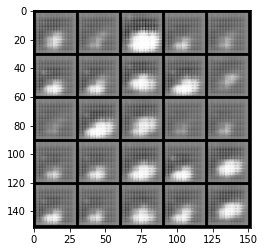

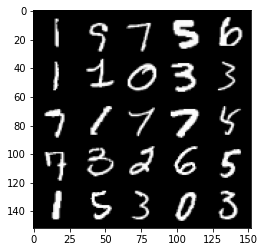

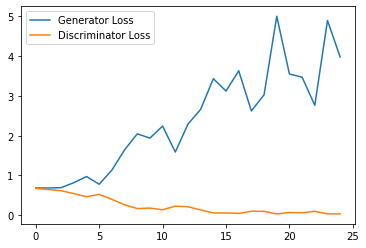

Step 1000: Generator loss: 4.166252278327942, discriminator loss: 0.03884797669854015


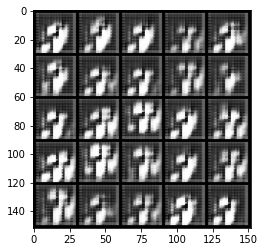

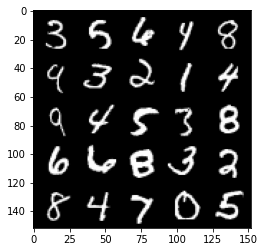

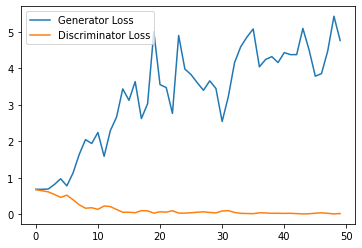

Step 1500: Generator loss: 4.152390822887421, discriminator loss: 0.06691187348589302


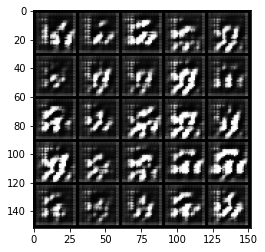

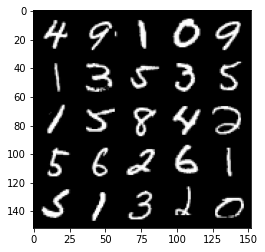

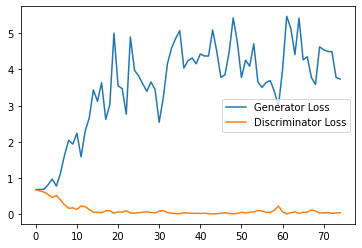

Step 2000: Generator loss: 3.6648474812507628, discriminator loss: 0.09792262231186032


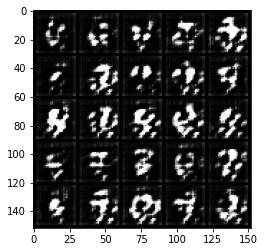

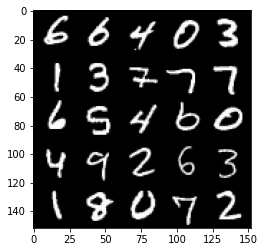

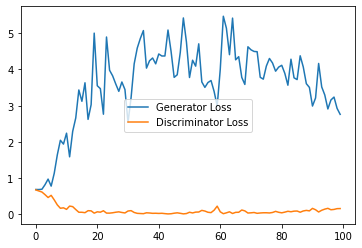

Step 2500: Generator loss: 2.751506018161774, discriminator loss: 0.2268457550778985


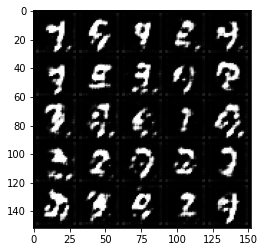

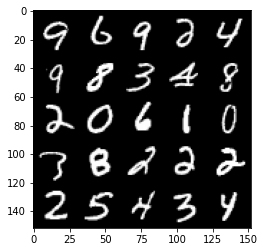

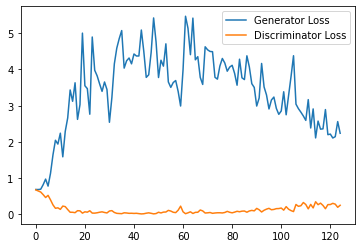

Step 3000: Generator loss: 2.2888986089229584, discriminator loss: 0.3079068736433983


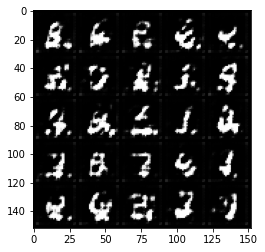

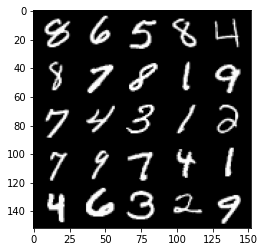

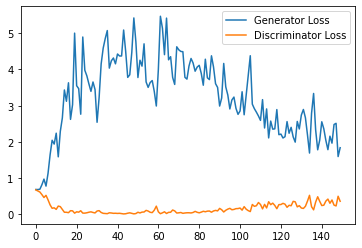

Step 3500: Generator loss: 2.106710248470306, discriminator loss: 0.29704996855556964


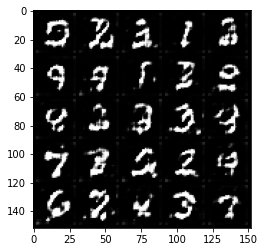

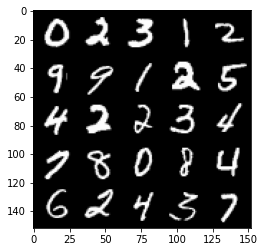

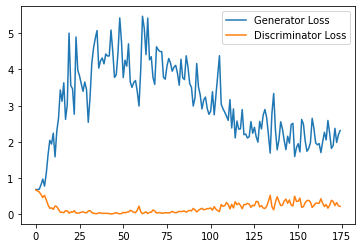

Step 4000: Generator loss: 2.1272756428718567, discriminator loss: 0.3167037697732449


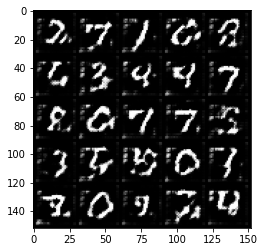

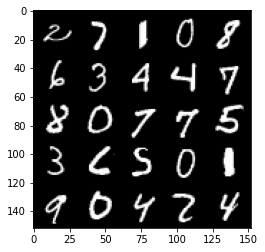

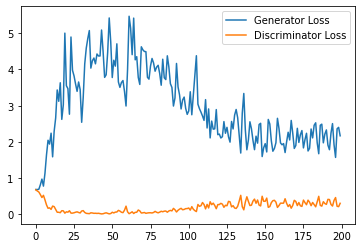

Step 4500: Generator loss: 2.1743762357234955, discriminator loss: 0.35375870087742806


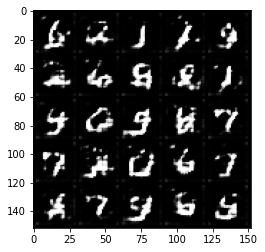

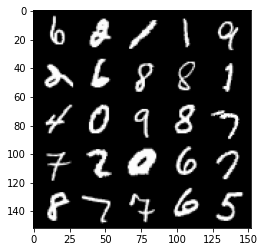

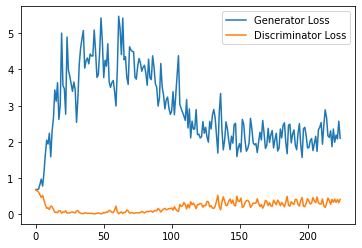

Step 5000: Generator loss: 1.8976319444179535, discriminator loss: 0.3523863865882158


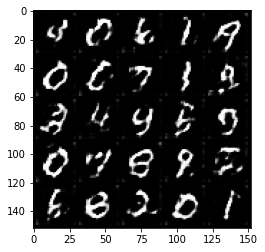

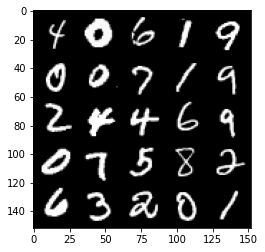

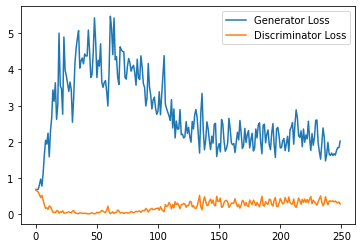

Step 5500: Generator loss: 1.778084642648697, discriminator loss: 0.3728799015879631


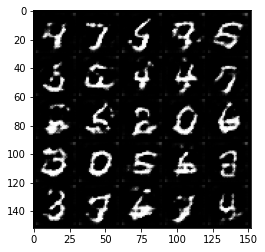

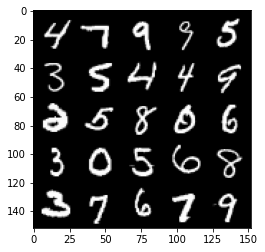

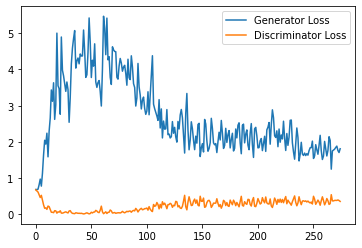

Step 6000: Generator loss: 1.6527620453834533, discriminator loss: 0.4036827082633972


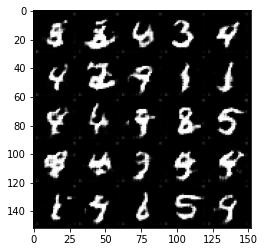

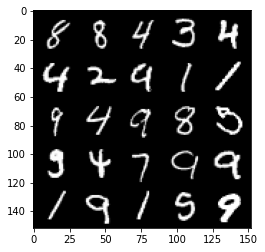

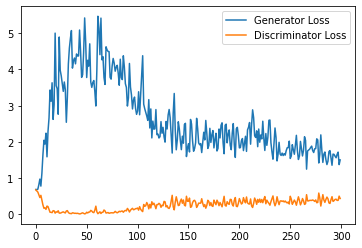

Step 6500: Generator loss: 1.5780909460783006, discriminator loss: 0.4471011900007725


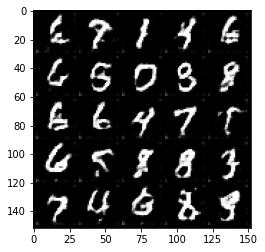

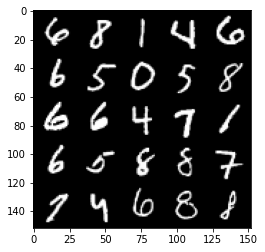

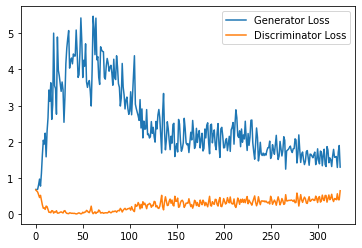

Step 7000: Generator loss: 1.423709188580513, discriminator loss: 0.4779058265388012


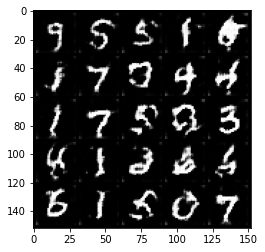

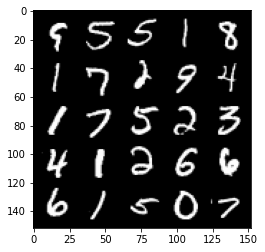

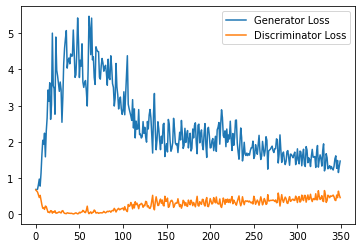

Step 7500: Generator loss: 1.3725743689537049, discriminator loss: 0.49958765453100207


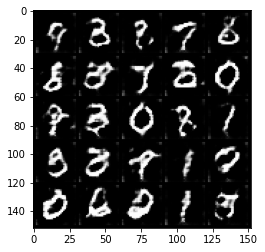

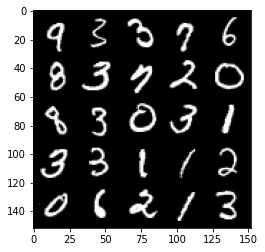

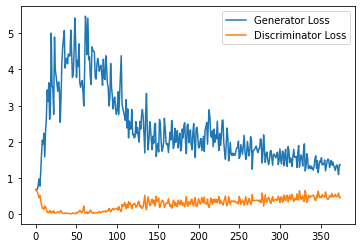

Step 8000: Generator loss: 1.335913421034813, discriminator loss: 0.5142680085897445


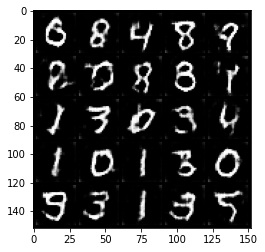

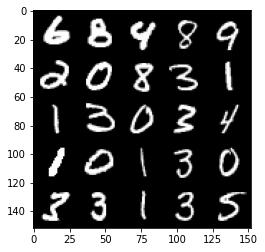

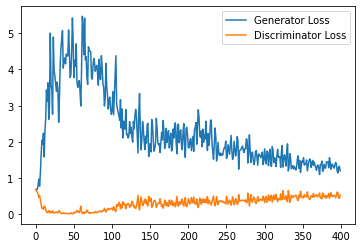

Step 8500: Generator loss: 1.2968983112573624, discriminator loss: 0.5394729197025299


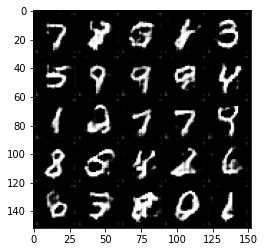

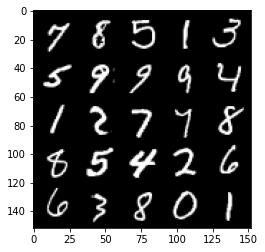

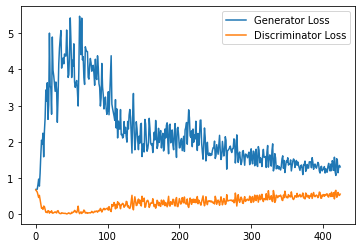

Step 9000: Generator loss: 1.3099472422599792, discriminator loss: 0.5351890217661858


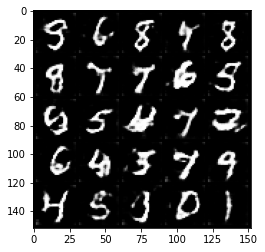

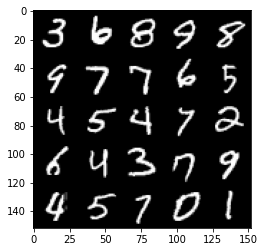

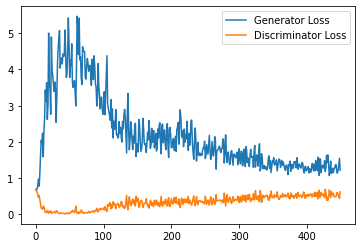

Step 9500: Generator loss: 1.205431053161621, discriminator loss: 0.5401545171141624


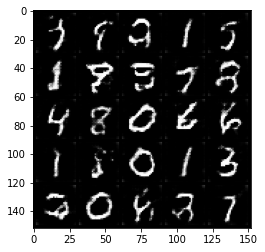

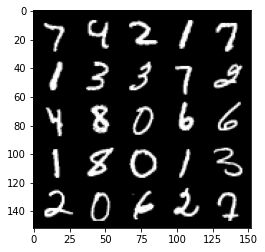

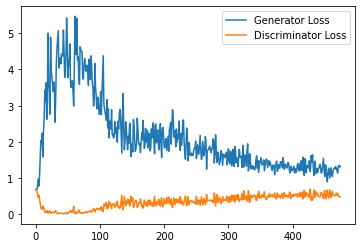

Step 10000: Generator loss: 1.2210836646556855, discriminator loss: 0.5421204439997673


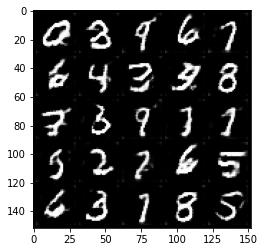

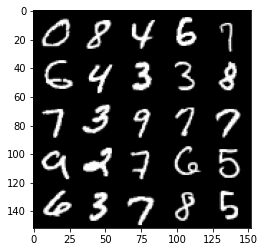

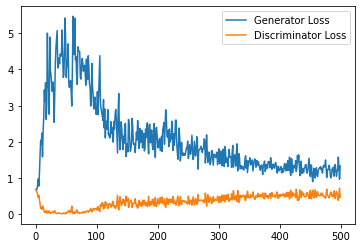

Step 10500: Generator loss: 1.1907907464504242, discriminator loss: 0.5485608737468719


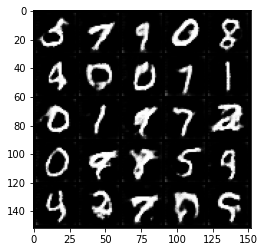

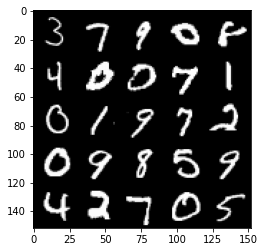

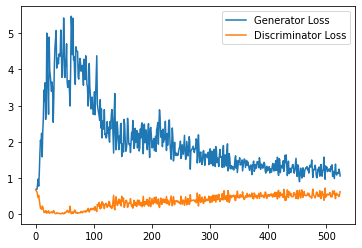

Step 11000: Generator loss: 1.1614860963821412, discriminator loss: 0.5556728204488754


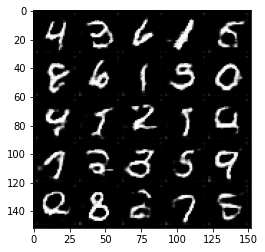

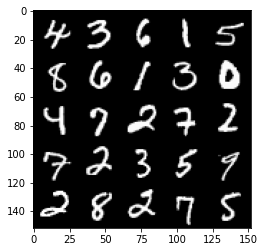

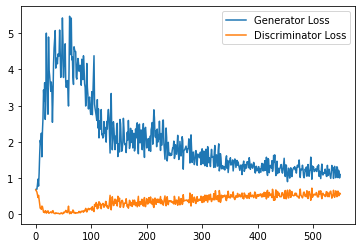

Step 11500: Generator loss: 1.1663321331739425, discriminator loss: 0.5703416261076927


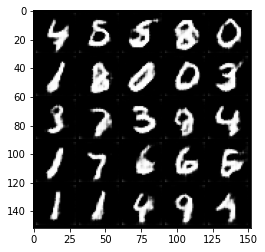

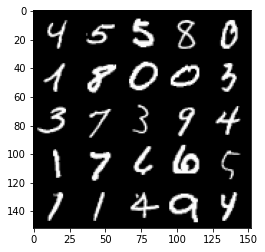

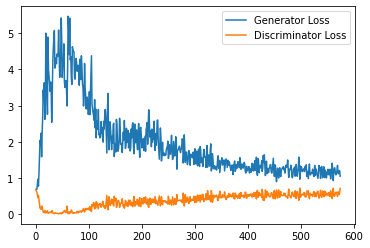

Step 12000: Generator loss: 1.176941871523857, discriminator loss: 0.5626272164583206


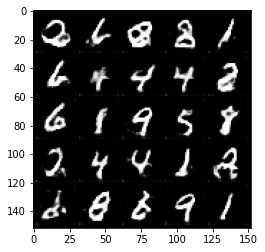

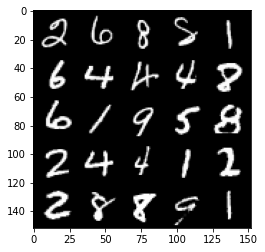

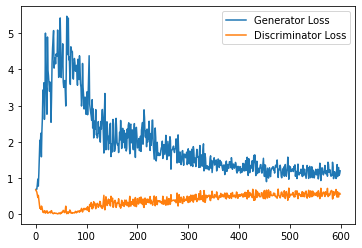

Step 12500: Generator loss: 1.1601173844337462, discriminator loss: 0.5676445369720459


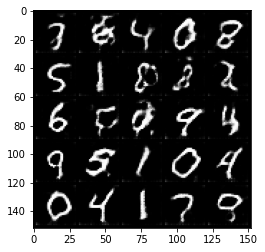

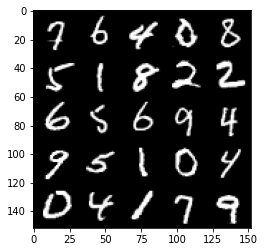

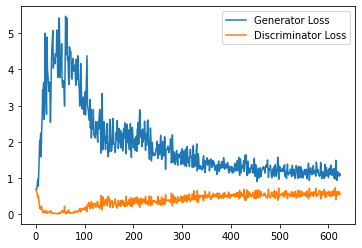

Step 13000: Generator loss: 1.1102661064863204, discriminator loss: 0.5752111896276474


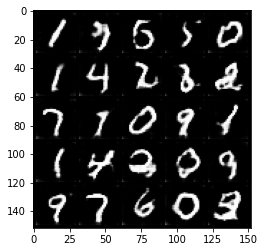

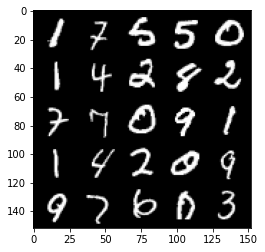

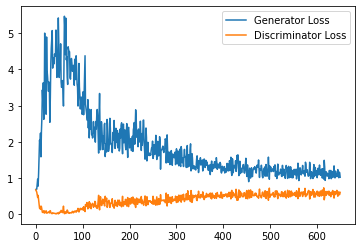

Step 13500: Generator loss: 1.116977942109108, discriminator loss: 0.5717113605737686


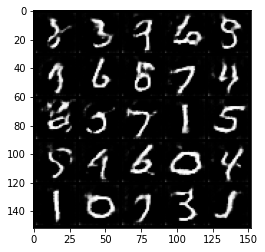

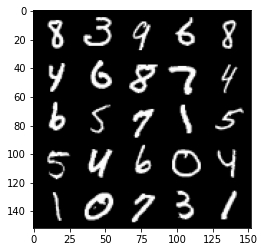

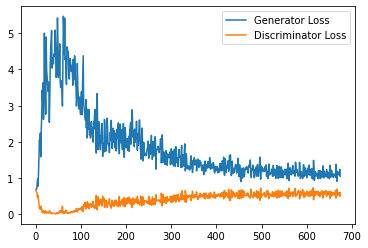

Step 14000: Generator loss: 1.0812950353622437, discriminator loss: 0.5761965710520744


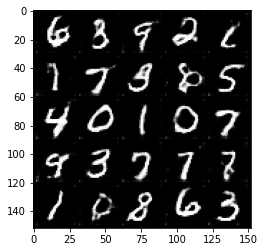

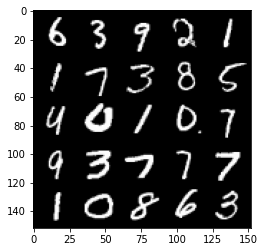

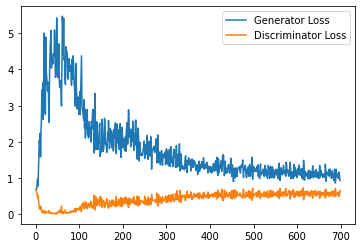

Step 14500: Generator loss: 1.0963331158161163, discriminator loss: 0.569070484161377


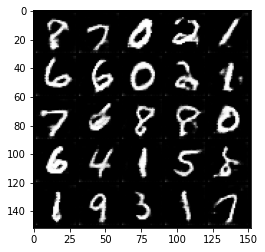

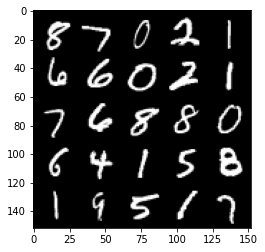

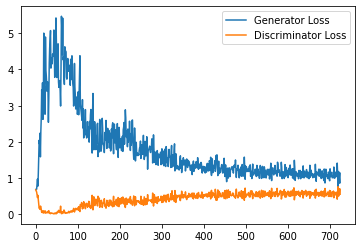

Step 15000: Generator loss: 1.0915854427814484, discriminator loss: 0.5817079230546951


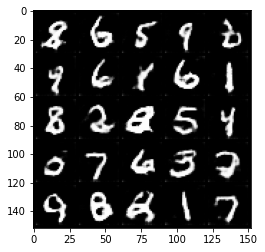

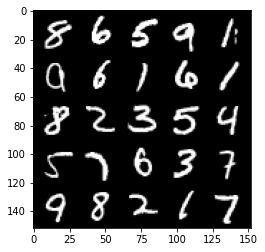

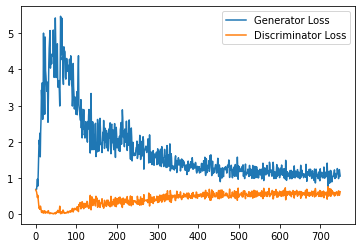

Step 15500: Generator loss: 1.0629878702163695, discriminator loss: 0.5809581515789032


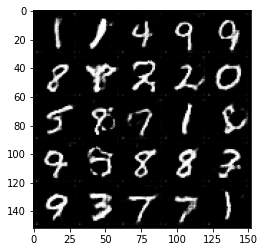

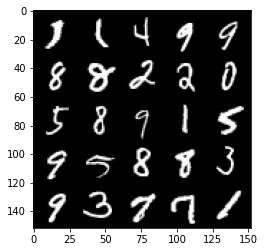

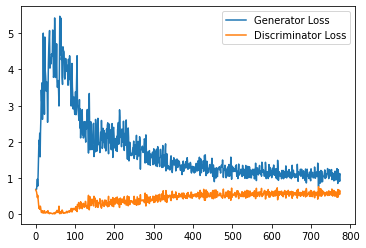

Step 16000: Generator loss: 1.0524217376708984, discriminator loss: 0.5800241857171059


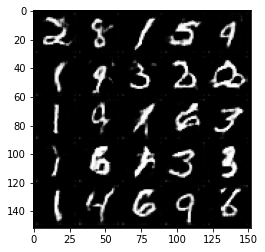

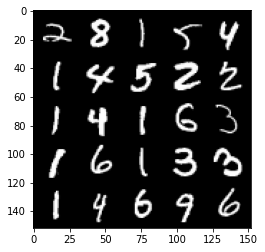

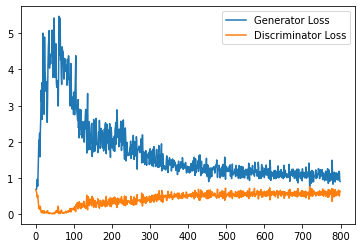

Step 16500: Generator loss: 1.1151115976572037, discriminator loss: 0.5759097419381142


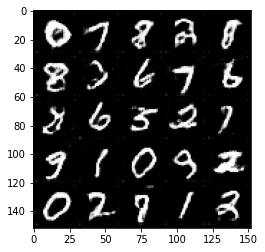

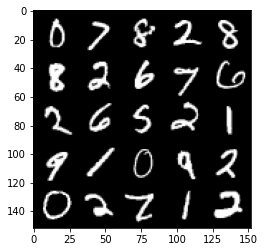

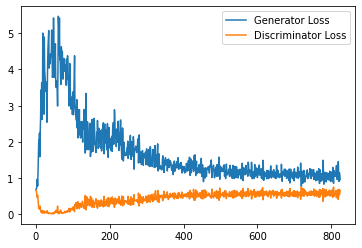

Step 17000: Generator loss: 1.0834220465421676, discriminator loss: 0.5800024081468582


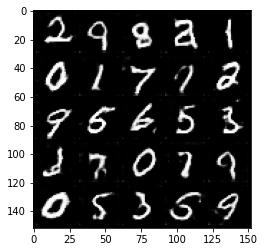

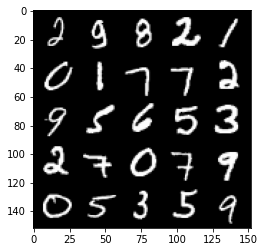

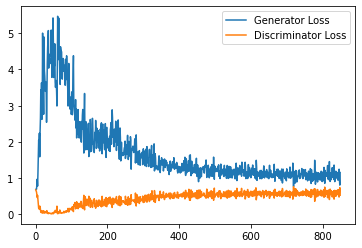

Step 17500: Generator loss: 1.0436064554452895, discriminator loss: 0.5829054955244064


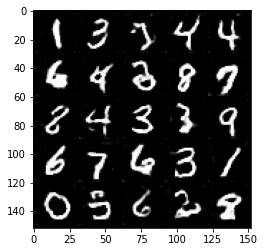

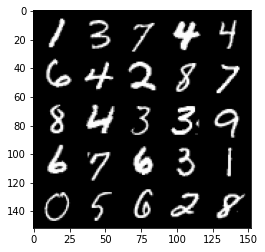

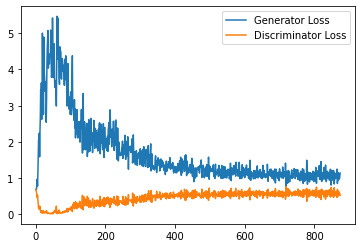

Step 18000: Generator loss: 1.003252749323845, discriminator loss: 0.5949444383382797


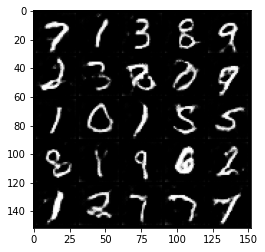

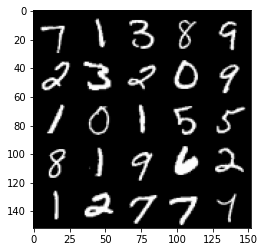

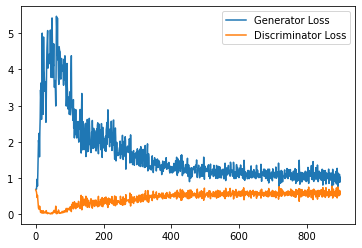

Step 18500: Generator loss: 1.0484280890226365, discriminator loss: 0.5859144356250763


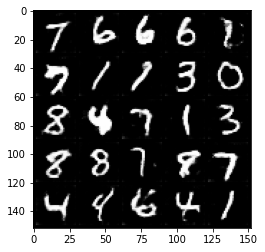

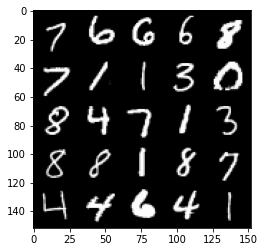

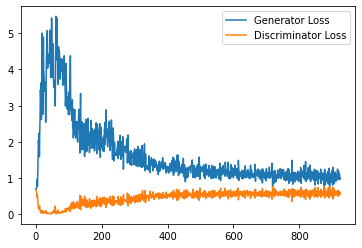

Step 19000: Generator loss: 1.0419052965641022, discriminator loss: 0.5871966924071312


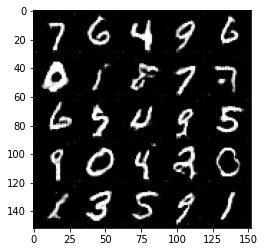

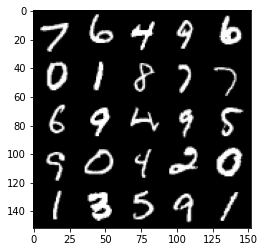

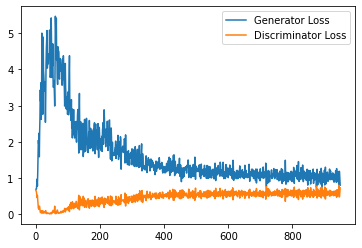

Step 19500: Generator loss: 1.0313934245109557, discriminator loss: 0.5827920163273811


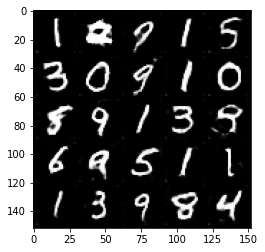

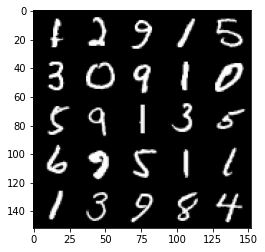

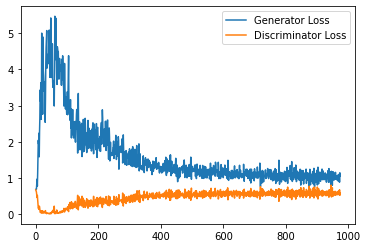

Step 20000: Generator loss: 1.0641085122823715, discriminator loss: 0.5793380396962166


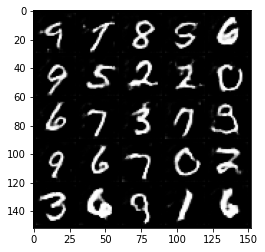

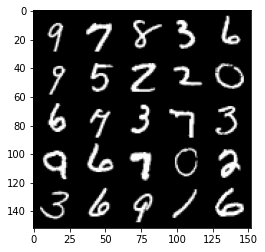

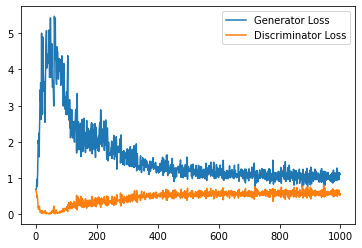

Step 20500: Generator loss: 1.0412175315618515, discriminator loss: 0.5877518157362938


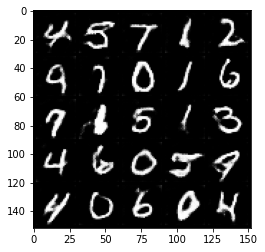

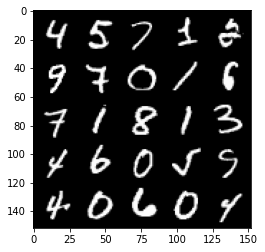

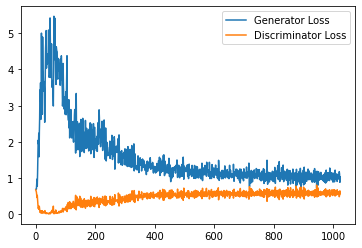

Step 21000: Generator loss: 1.0068270235061645, discriminator loss: 0.596325780570507


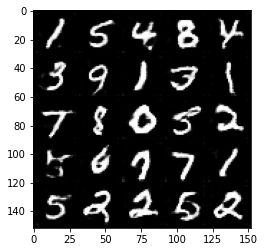

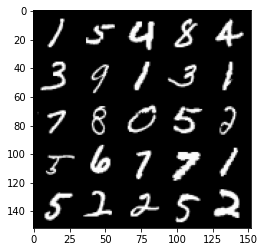

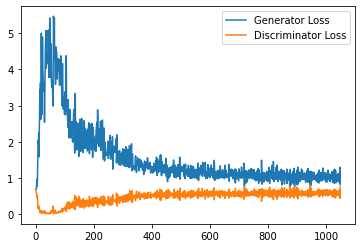

Step 21500: Generator loss: 1.017287304520607, discriminator loss: 0.5908094407916069


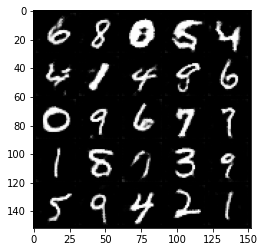

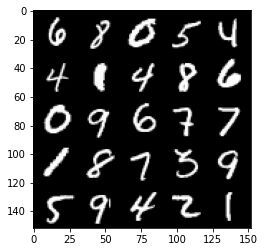

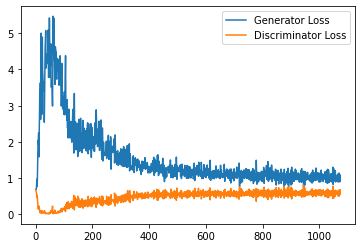

Step 22000: Generator loss: 1.031779602766037, discriminator loss: 0.5919092955589295


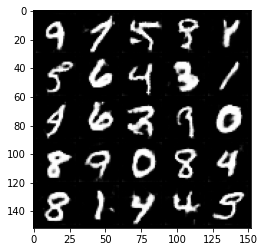

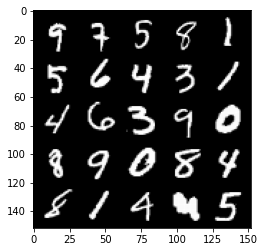

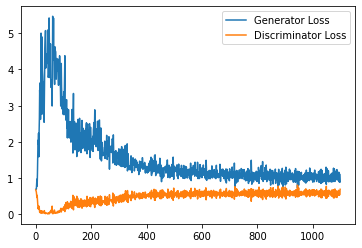

Step 22500: Generator loss: 1.009196994304657, discriminator loss: 0.5871717741489411


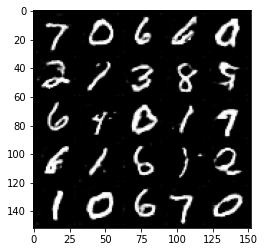

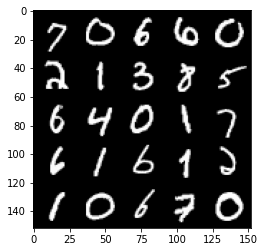

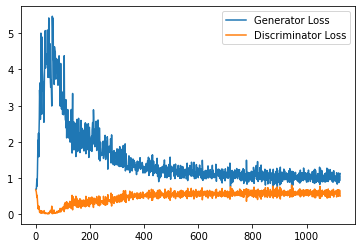

Step 23000: Generator loss: 0.9951462323665619, discriminator loss: 0.5982236747741699


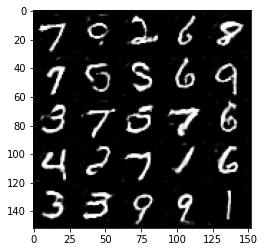

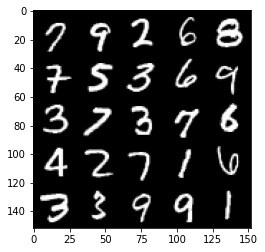

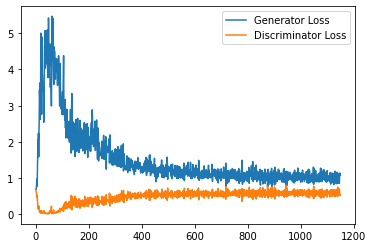

Step 23500: Generator loss: 1.001919445514679, discriminator loss: 0.5908153669238091


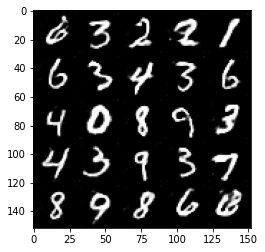

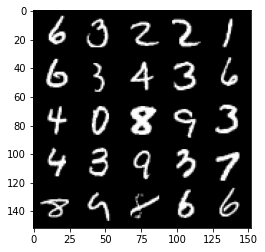

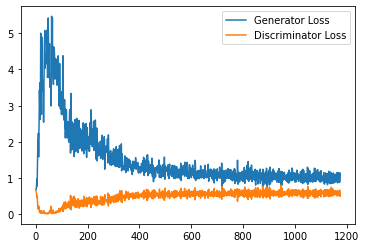

Step 24000: Generator loss: 1.0034186301231385, discriminator loss: 0.5951668916940689


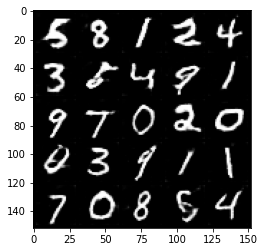

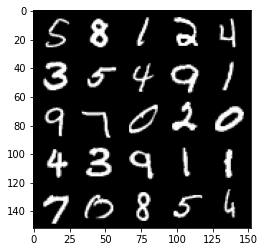

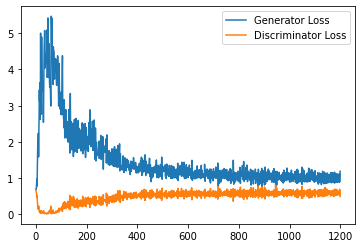

Step 24500: Generator loss: 1.0114465560913086, discriminator loss: 0.5964214077591896


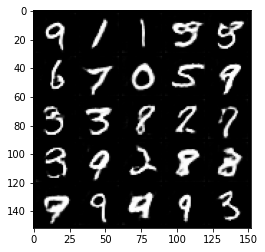

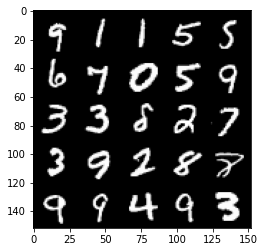

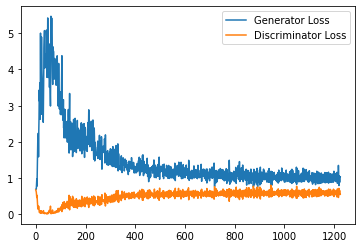

Step 25000: Generator loss: 0.9786127625703812, discriminator loss: 0.59651628947258


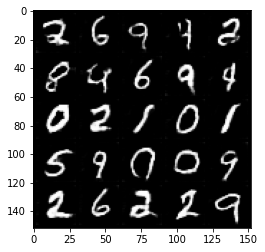

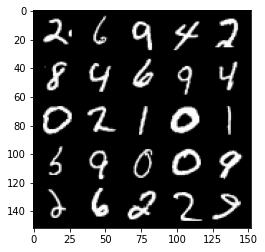

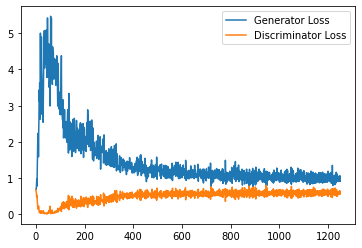

Step 25500: Generator loss: 0.9914566066265106, discriminator loss: 0.5879573336839676


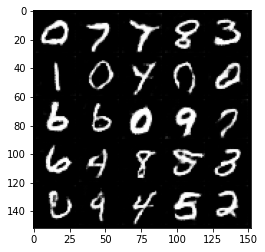

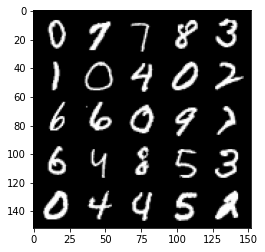

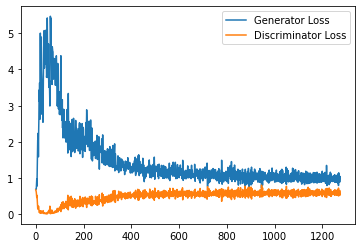

Step 26000: Generator loss: 1.0134741151332856, discriminator loss: 0.5945366994142532


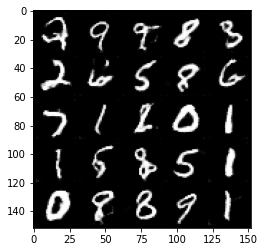

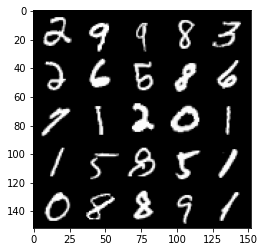

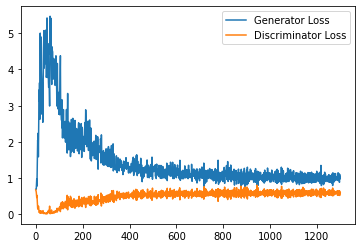

Step 26500: Generator loss: 1.014768030166626, discriminator loss: 0.588273660838604


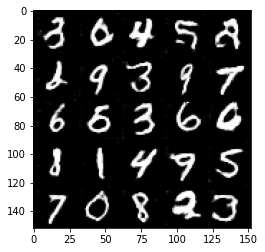

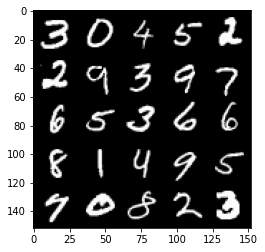

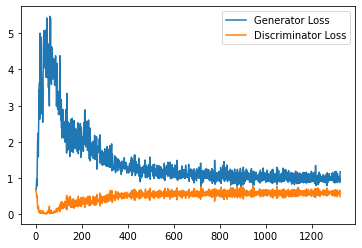

Step 27000: Generator loss: 1.0039307181835175, discriminator loss: 0.597167424440384


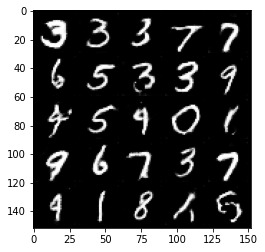

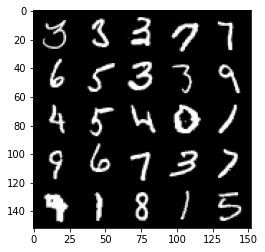

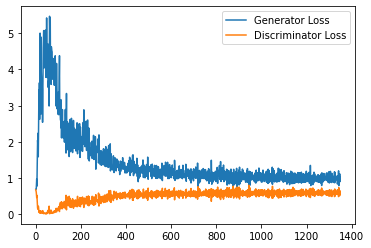

Step 27500: Generator loss: 1.0174601051807404, discriminator loss: 0.5941141446232796


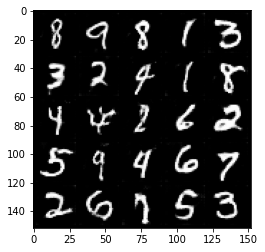

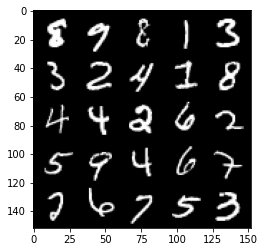

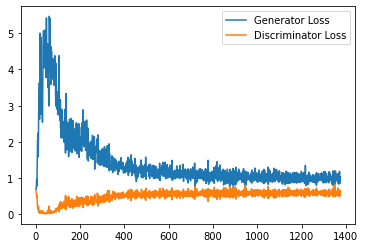

Step 28000: Generator loss: 0.995083228468895, discriminator loss: 0.5885022248625755


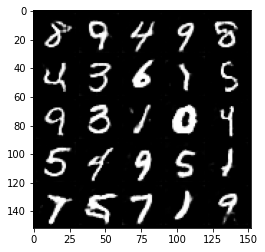

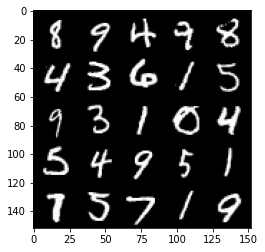

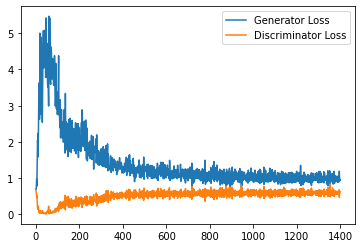

Step 28500: Generator loss: 1.002722004532814, discriminator loss: 0.5936777173876763


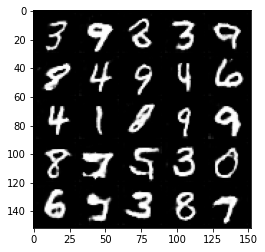

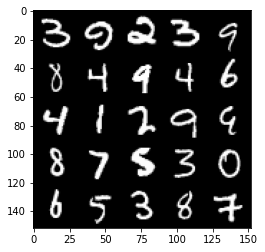

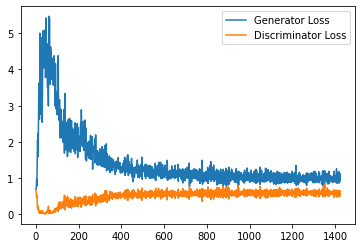

Step 29000: Generator loss: 1.0073919572830201, discriminator loss: 0.5837537581324578


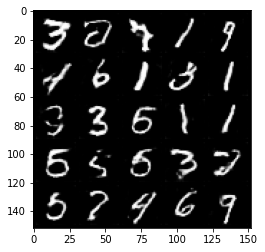

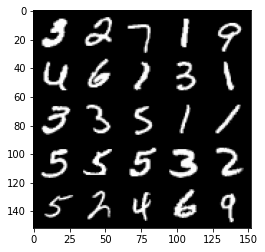

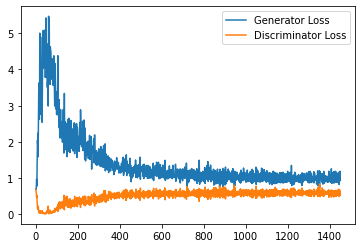

Step 29500: Generator loss: 0.9964267888069153, discriminator loss: 0.5912185143828392


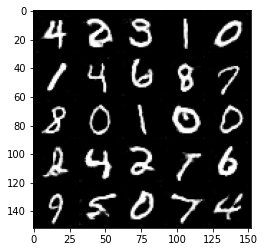

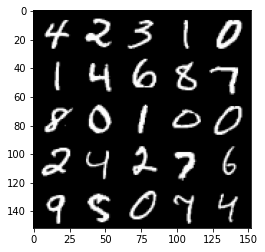

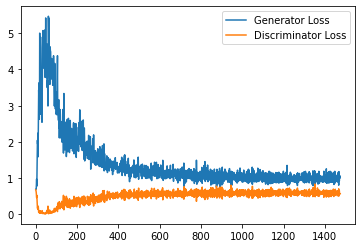

Step 30000: Generator loss: 1.012595121741295, discriminator loss: 0.5902920149564743


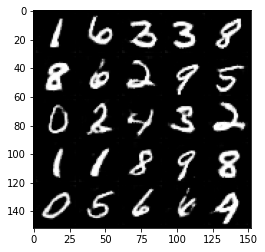

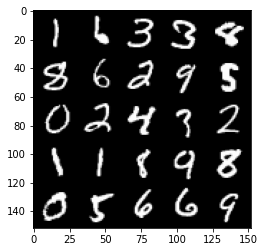

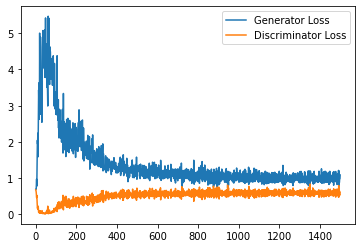

Step 30500: Generator loss: 1.0058193711042405, discriminator loss: 0.5857447809576988


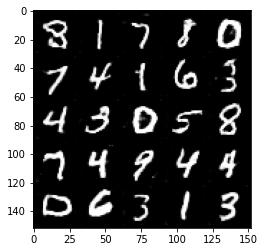

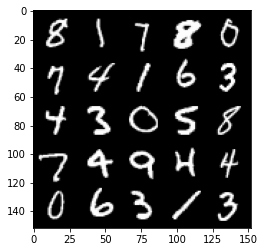

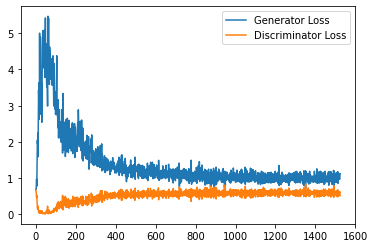

Step 31000: Generator loss: 1.0116767704486846, discriminator loss: 0.5922605039477349


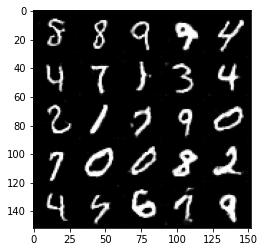

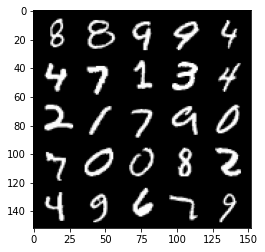

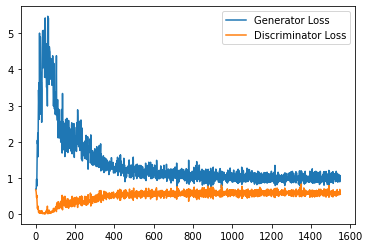

Step 31500: Generator loss: 0.9953190764188766, discriminator loss: 0.5881100917458534


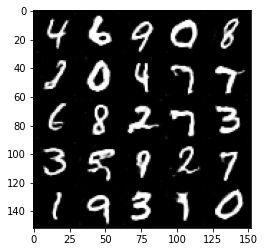

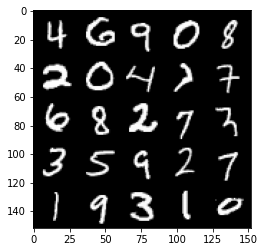

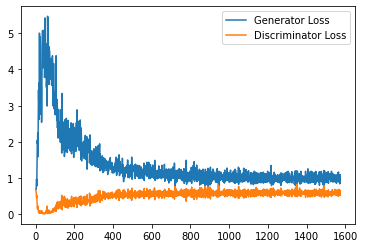

Step 32000: Generator loss: 1.0147612887620925, discriminator loss: 0.5900891122221946


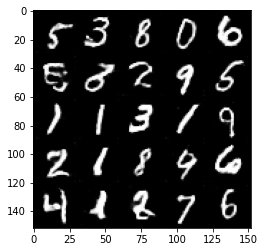

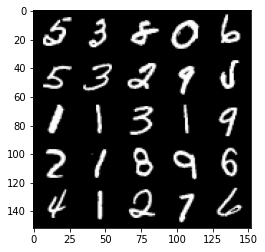

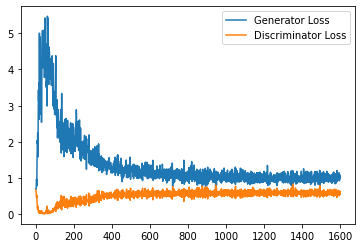

Step 32500: Generator loss: 0.9998402111530303, discriminator loss: 0.5942743740677834


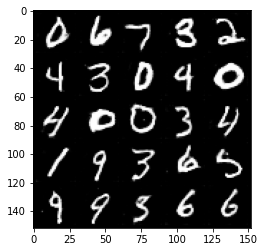

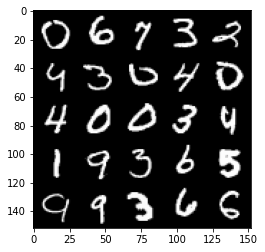

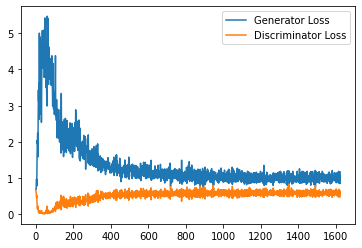

Step 33000: Generator loss: 0.9884706033468247, discriminator loss: 0.5966325784921647


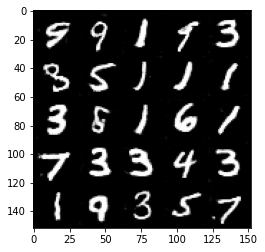

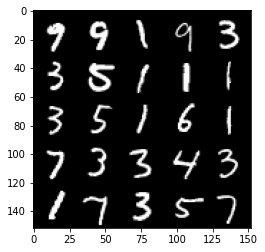

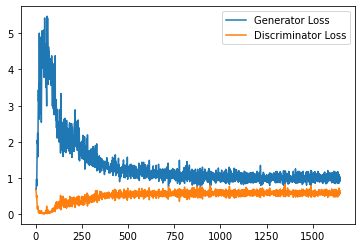

Step 33500: Generator loss: 1.027156723499298, discriminator loss: 0.5890577036142349


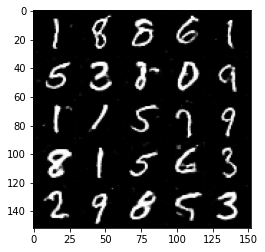

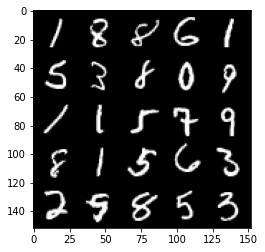

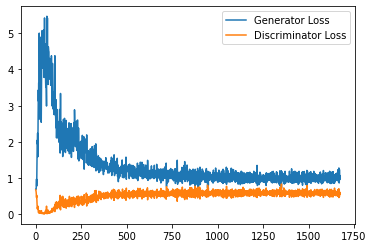

Step 34000: Generator loss: 1.017617374777794, discriminator loss: 0.5878350695967675


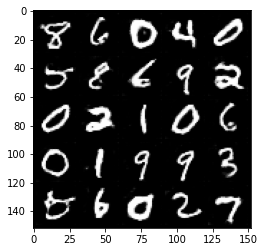

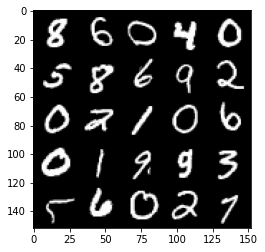

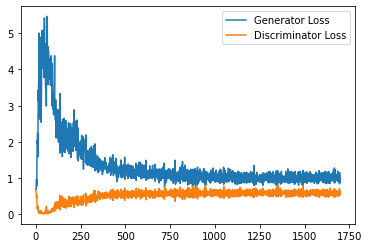

Step 34500: Generator loss: 1.0017144696712494, discriminator loss: 0.5914075150489807


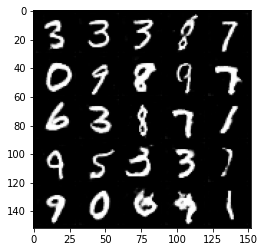

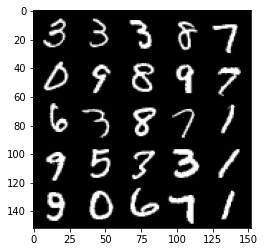

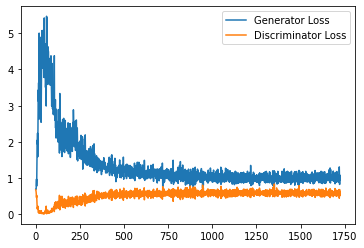

Step 35000: Generator loss: 0.9873604922294617, discriminator loss: 0.5917802782654762


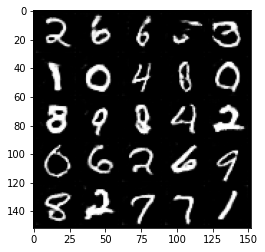

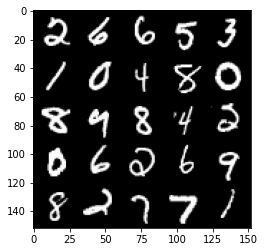

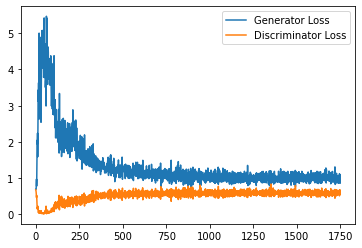

Step 35500: Generator loss: 1.0141049606800079, discriminator loss: 0.586899722635746


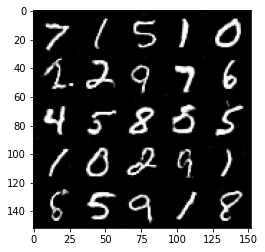

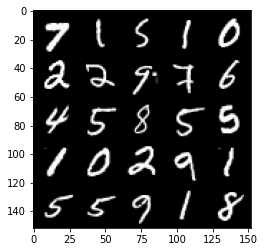

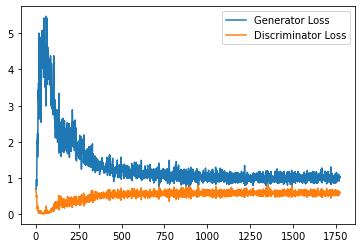

Step 36000: Generator loss: 0.9931385966539383, discriminator loss: 0.5931749760508537


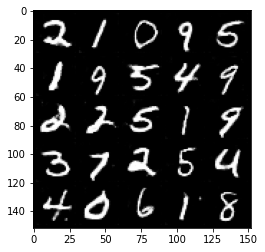

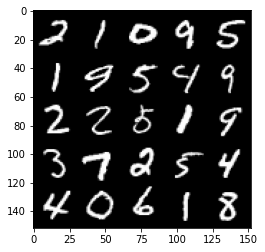

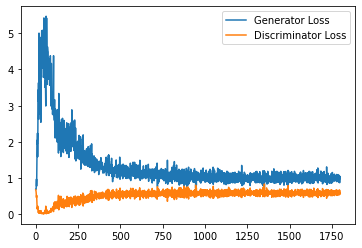

Step 36500: Generator loss: 1.0016104992628097, discriminator loss: 0.5932893409132958


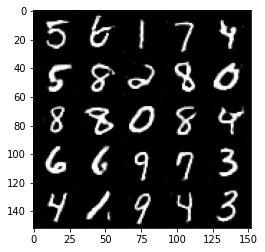

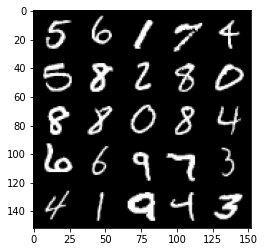

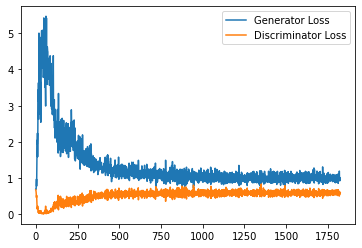

Step 37000: Generator loss: 0.9914649667739868, discriminator loss: 0.5960688437819481


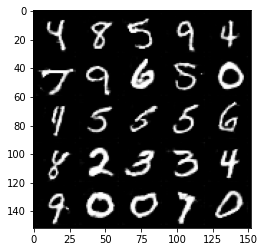

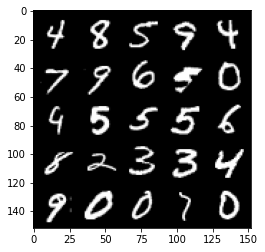

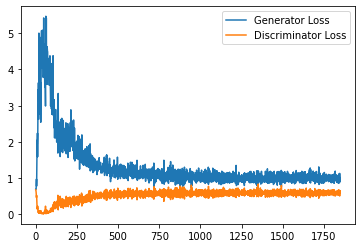

Step 37500: Generator loss: 1.015962774991989, discriminator loss: 0.5945385094881058


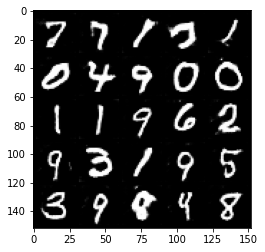

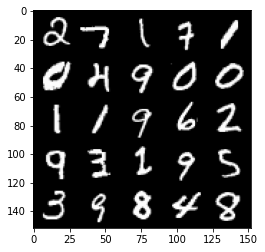

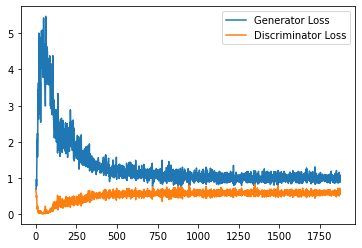

Step 38000: Generator loss: 1.015185510635376, discriminator loss: 0.5889079000353813


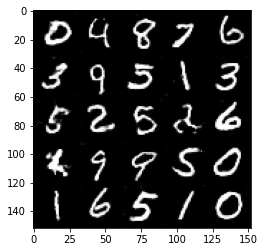

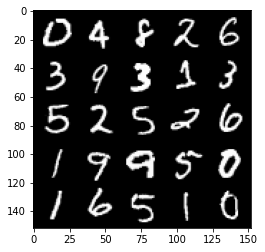

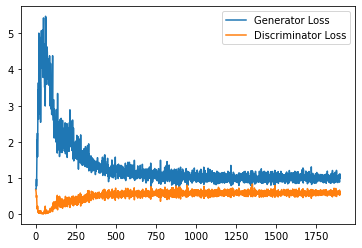

Step 38500: Generator loss: 1.0170805115699768, discriminator loss: 0.5888038491010665


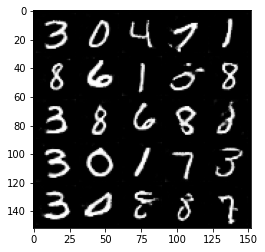

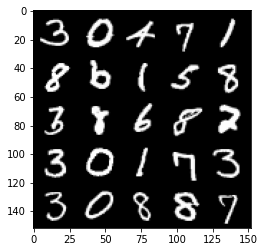

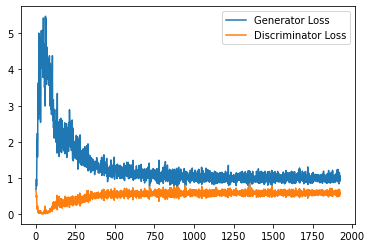

Step 39000: Generator loss: 0.9852464748620987, discriminator loss: 0.5930462056398391


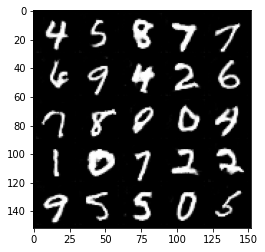

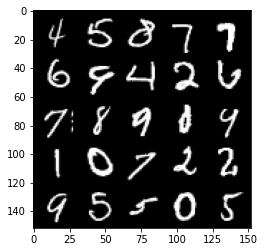

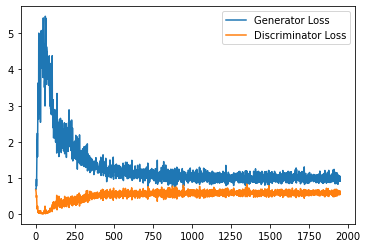

Step 39500: Generator loss: 0.9841898518800736, discriminator loss: 0.5928176647424698


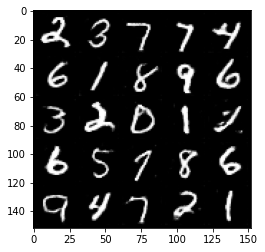

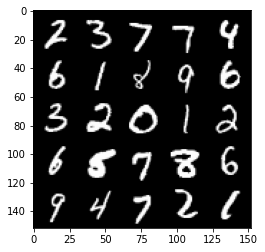

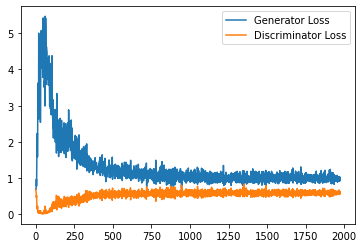

Step 40000: Generator loss: 0.9923380436897278, discriminator loss: 0.5912124172449112


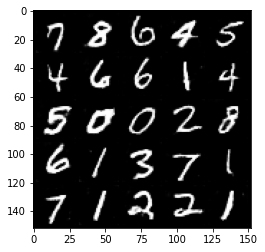

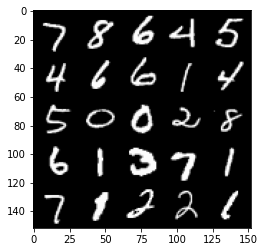

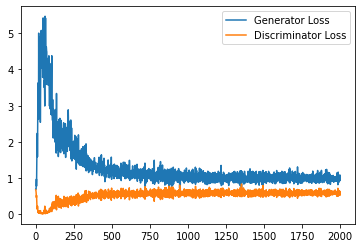

Step 40500: Generator loss: 0.9797434471845626, discriminator loss: 0.5922862998843194


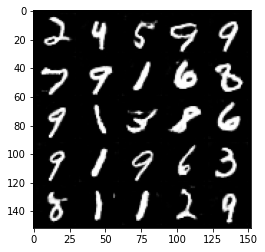

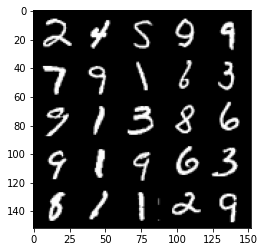

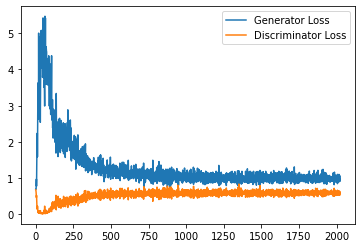

Step 41000: Generator loss: 0.9948644530773163, discriminator loss: 0.6000489417910576


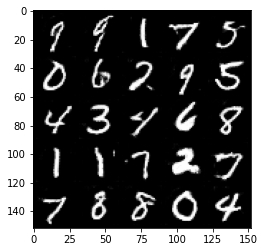

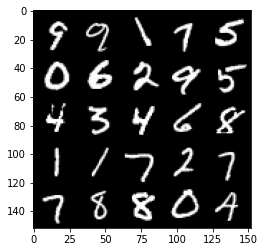

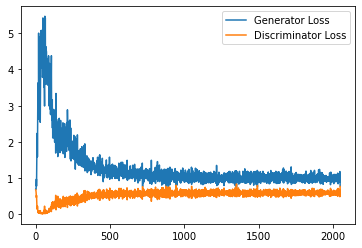

Step 41500: Generator loss: 1.026052851676941, discriminator loss: 0.5851727372407913


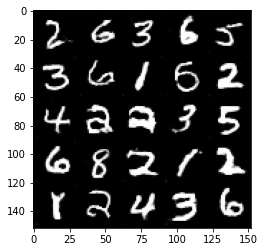

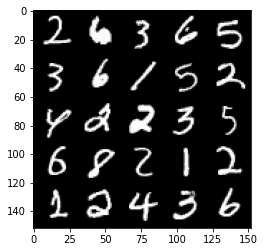

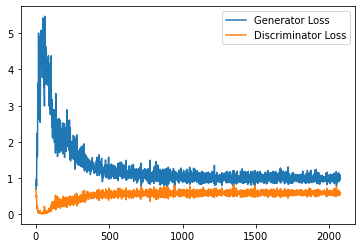

Step 42000: Generator loss: 1.0022775460481643, discriminator loss: 0.5906286025643349


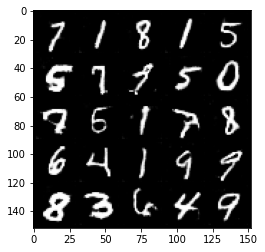

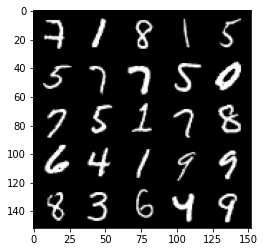

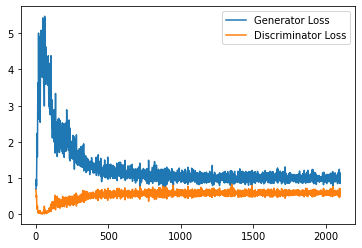

Step 42500: Generator loss: 1.037315500497818, discriminator loss: 0.5854677159786225


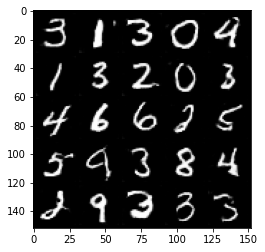

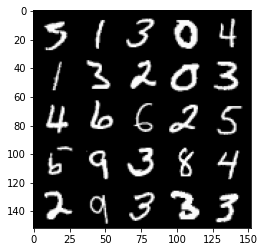

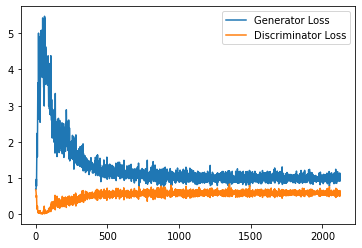

Step 43000: Generator loss: 1.008452735543251, discriminator loss: 0.5920803010463714


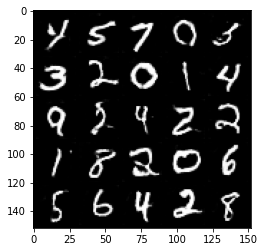

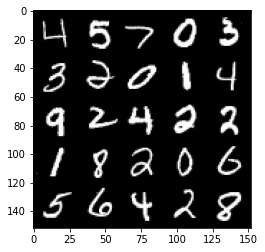

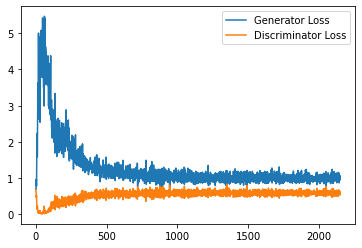

Step 43500: Generator loss: 1.0135840213298797, discriminator loss: 0.5935532537698746


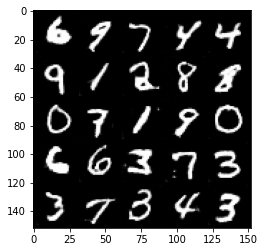

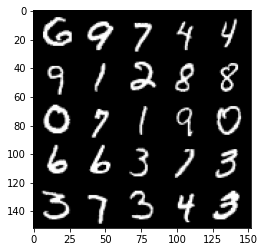

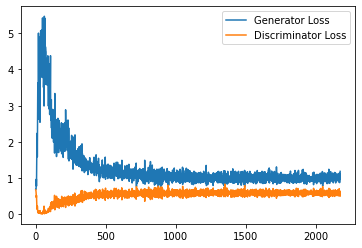

Step 44000: Generator loss: 1.0186919585466385, discriminator loss: 0.5975978416204453


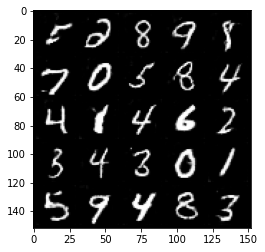

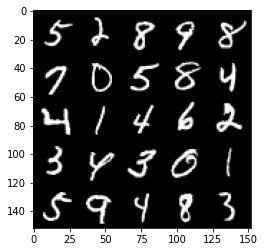

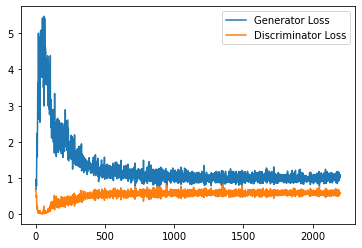

Step 44500: Generator loss: 1.007673649430275, discriminator loss: 0.5964174405932426


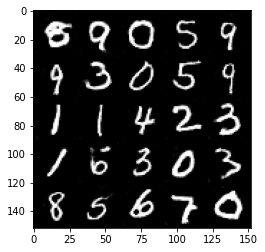

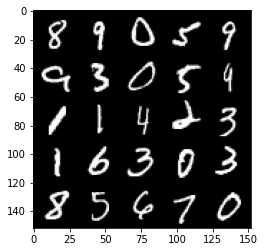

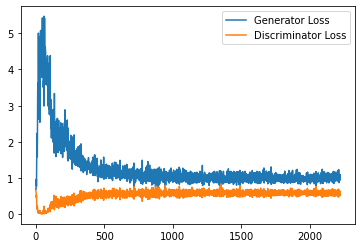

Step 45000: Generator loss: 1.0001943562030793, discriminator loss: 0.5958911921381951


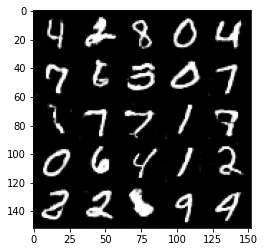

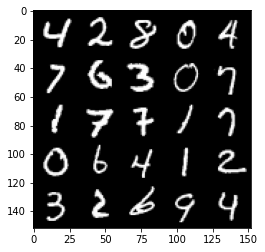

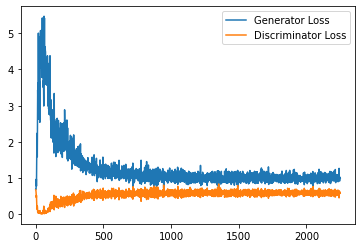

Step 45500: Generator loss: 1.0101185735464095, discriminator loss: 0.5988563095331192


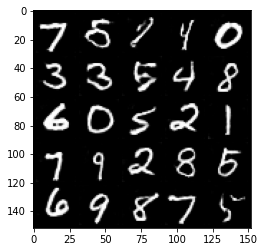

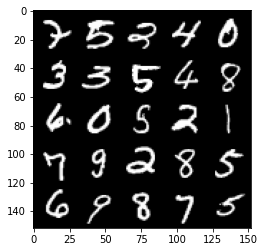

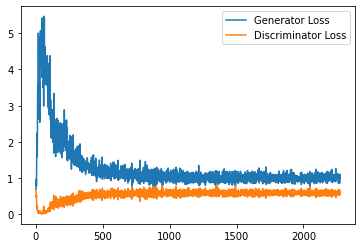

Step 46000: Generator loss: 1.0018242157697677, discriminator loss: 0.596232450902462


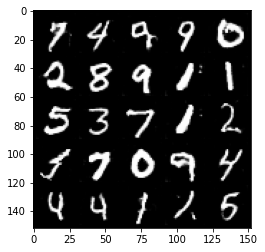

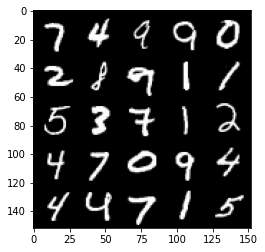

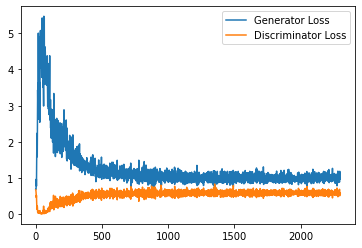

Step 46500: Generator loss: 0.9930635083913804, discriminator loss: 0.5964294248223305


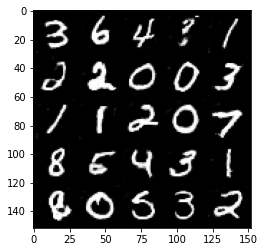

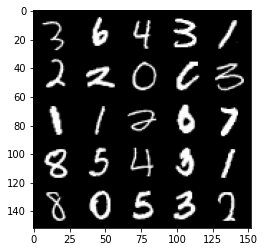

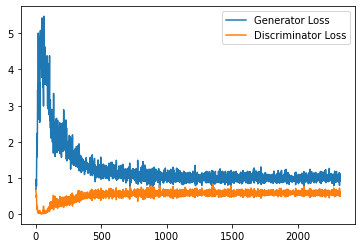

Step 47000: Generator loss: 0.9931203907728196, discriminator loss: 0.5953257637619972


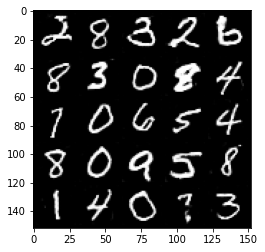

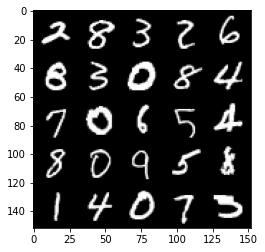

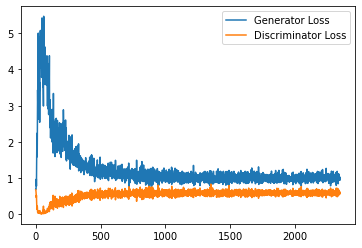

Step 47500: Generator loss: 0.9765876064300537, discriminator loss: 0.6020360370874405


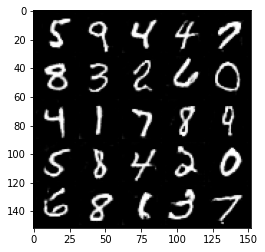

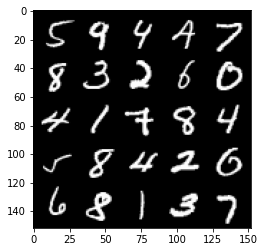

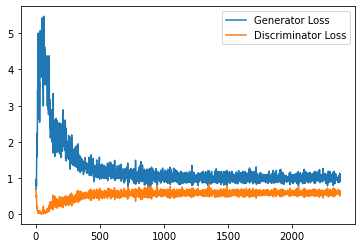

Step 48000: Generator loss: 0.9965888324975968, discriminator loss: 0.5973001103401184


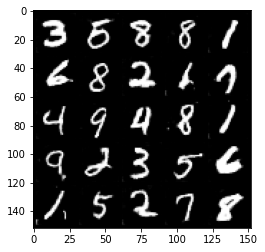

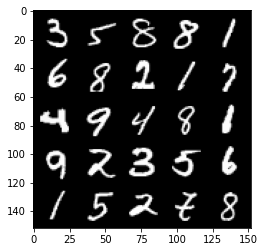

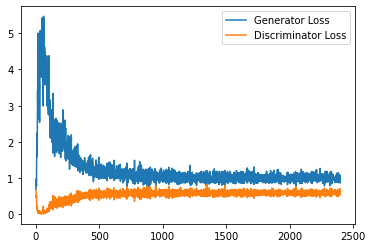

Step 48500: Generator loss: 1.0071326175928115, discriminator loss: 0.5969004044532776


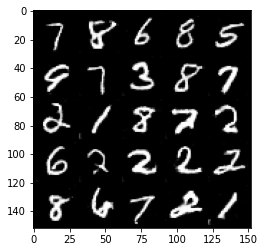

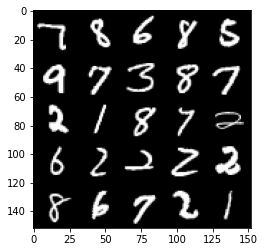

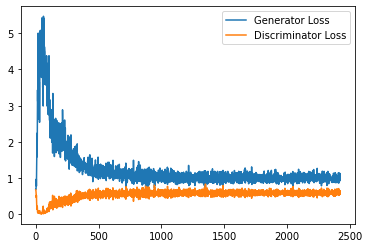

Step 49000: Generator loss: 0.9922233396768569, discriminator loss: 0.5986790270209312


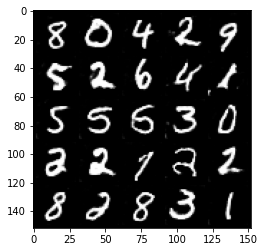

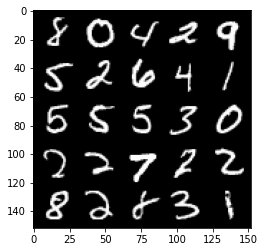

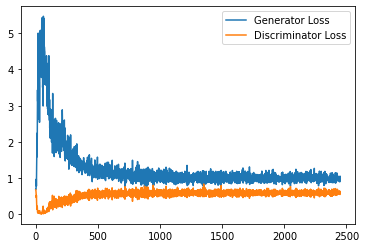

Step 49500: Generator loss: 0.9807321758270263, discriminator loss: 0.5985382975935936


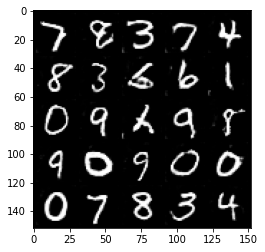

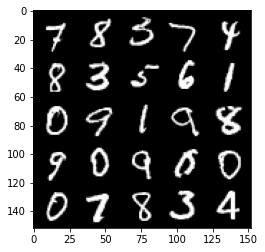

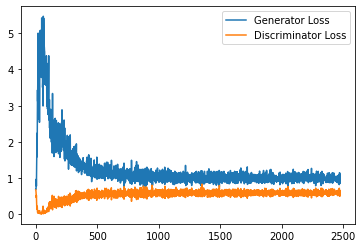

Step 50000: Generator loss: 0.9966621233224868, discriminator loss: 0.6026587929129601


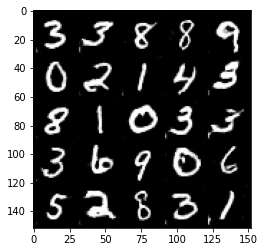

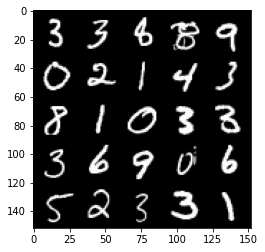

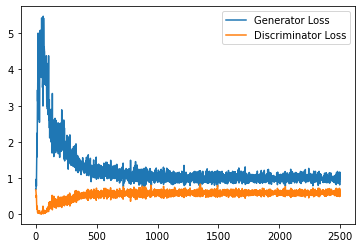

Step 50500: Generator loss: 1.0065965148210525, discriminator loss: 0.6054850382208824


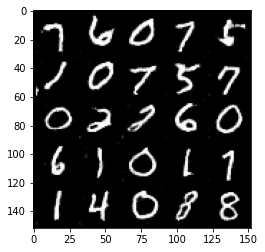

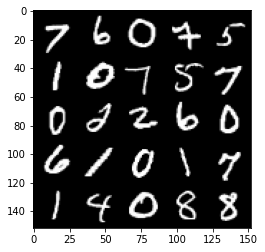

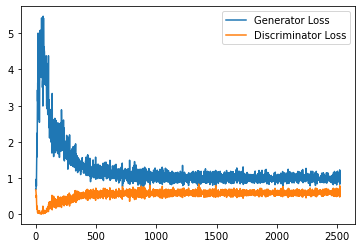

Step 51000: Generator loss: 1.0073014178276063, discriminator loss: 0.5945428383946418


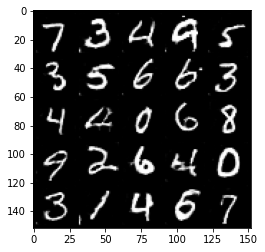

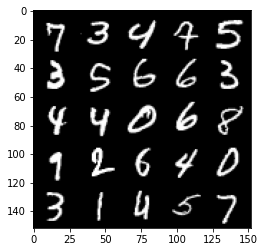

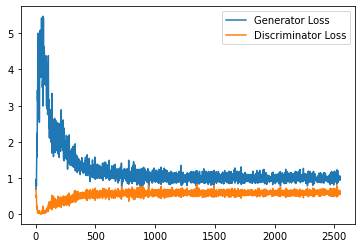

Step 51500: Generator loss: 0.97333445250988, discriminator loss: 0.6085583420991898


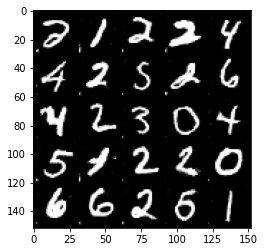

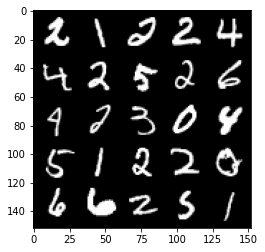

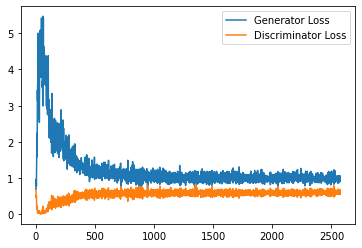

Step 52000: Generator loss: 0.9787415430545807, discriminator loss: 0.6022699612379074


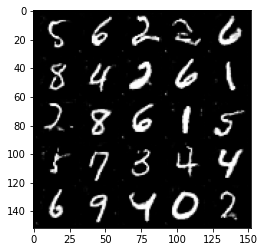

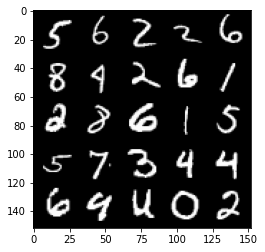

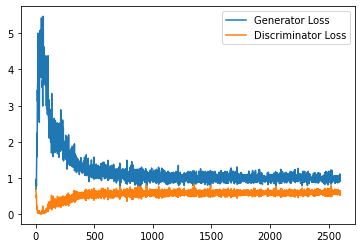

Step 52500: Generator loss: 0.9737903126478196, discriminator loss: 0.6085883288383483


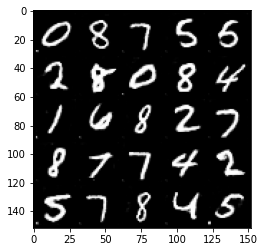

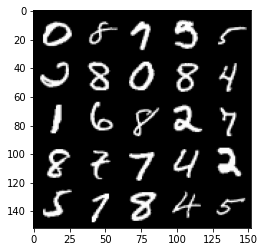

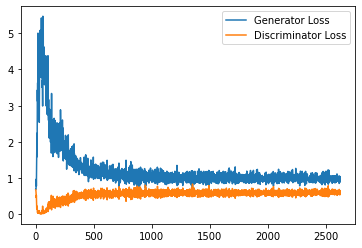

Step 53000: Generator loss: 0.9841098846197128, discriminator loss: 0.6035696584582328


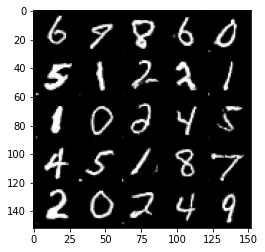

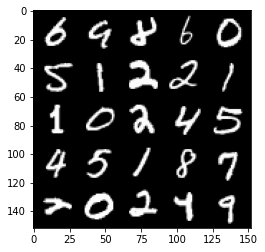

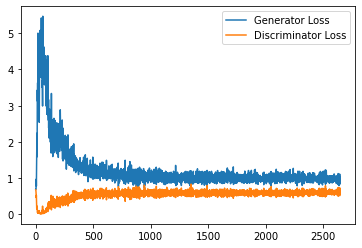

Step 53500: Generator loss: 0.9801595686674118, discriminator loss: 0.6023775998353958


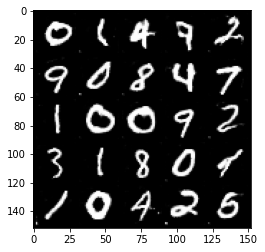

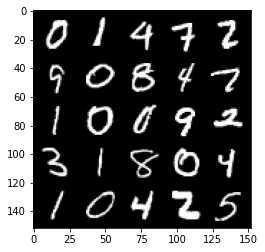

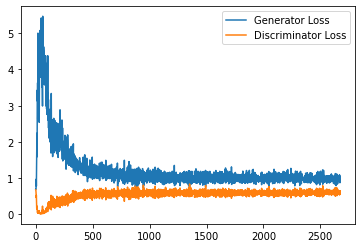

Step 54000: Generator loss: 0.9915611478090286, discriminator loss: 0.6002940666079521


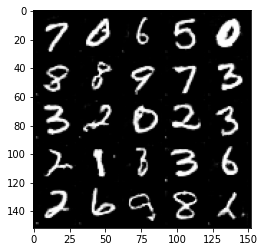

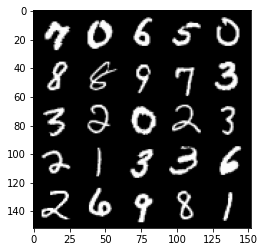

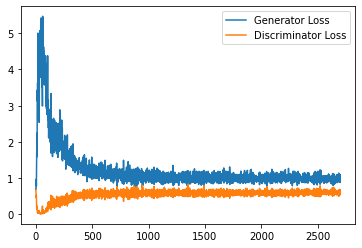

Step 54500: Generator loss: 0.9693770306110382, discriminator loss: 0.6093712355494499


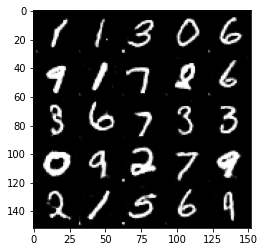

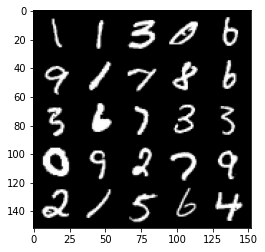

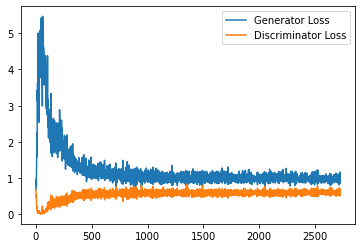

Step 55000: Generator loss: 0.9889259865283966, discriminator loss: 0.59882739508152


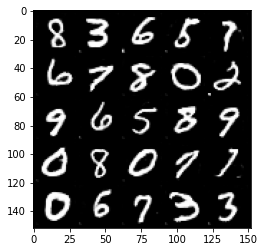

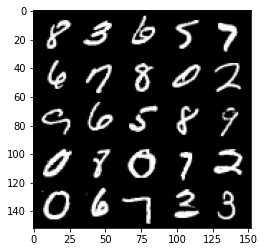

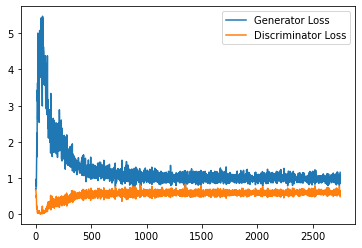

Step 55500: Generator loss: 0.9662952132225037, discriminator loss: 0.6109313982725143


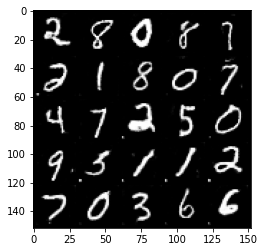

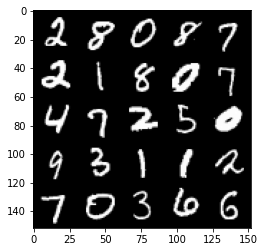

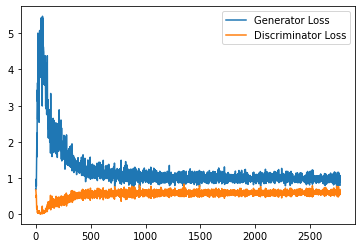

Step 56000: Generator loss: 0.9840727252960205, discriminator loss: 0.5955837661027908


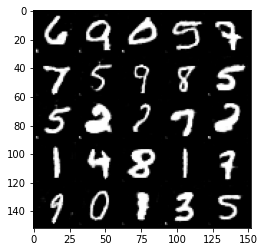

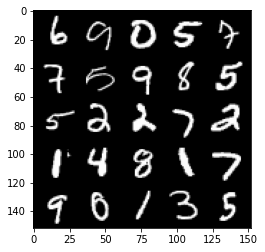

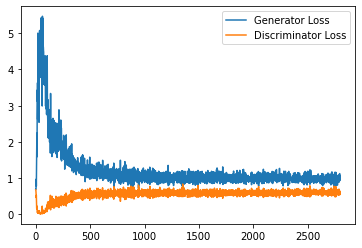

Step 56500: Generator loss: 0.9823103486299515, discriminator loss: 0.6040178605914116


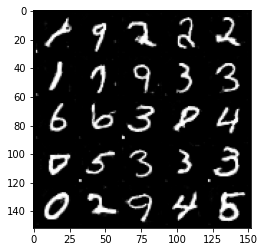

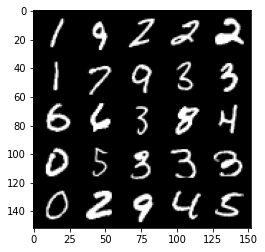

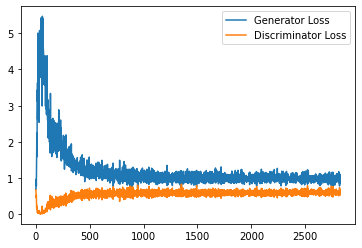

Step 57000: Generator loss: 0.9660002906322479, discriminator loss: 0.6060393370389938


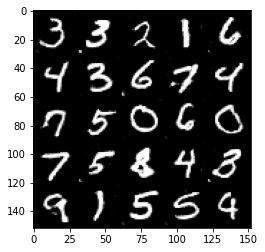

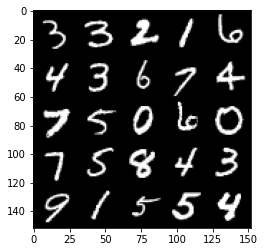

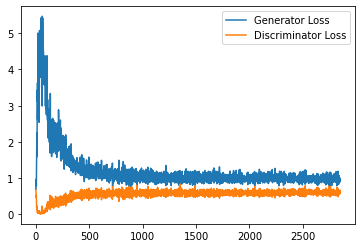

Step 57500: Generator loss: 0.9835925859212875, discriminator loss: 0.6082367118000984


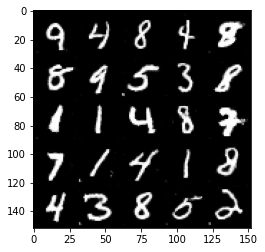

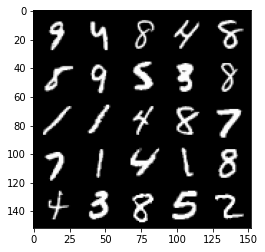

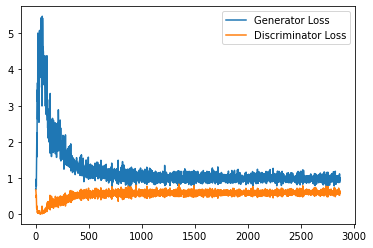

Step 58000: Generator loss: 0.9914199887514115, discriminator loss: 0.5992544124722481


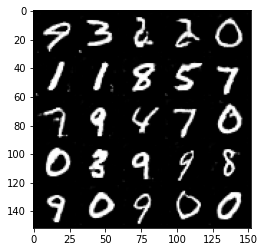

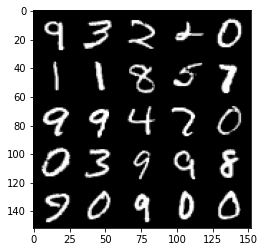

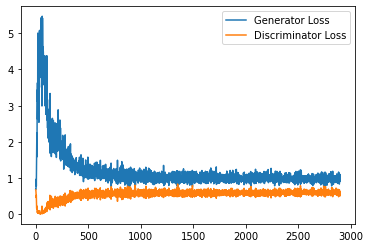

Step 58500: Generator loss: 0.9635027579069138, discriminator loss: 0.6087199872136116


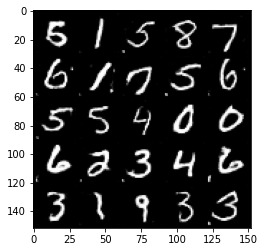

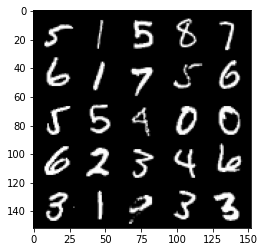

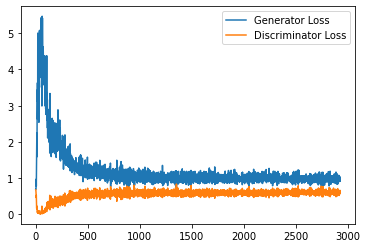

Step 59000: Generator loss: 0.9640985488891601, discriminator loss: 0.6084531990885734


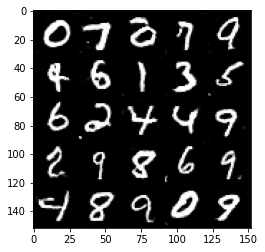

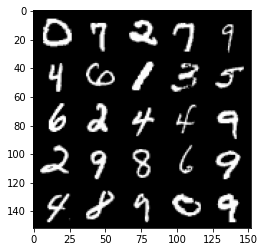

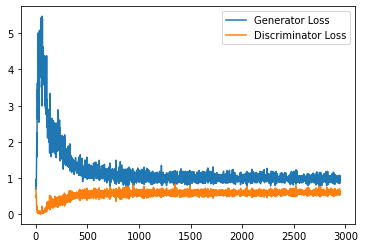

Step 59500: Generator loss: 0.9744847052097321, discriminator loss: 0.6049312734603882


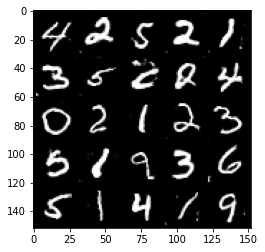

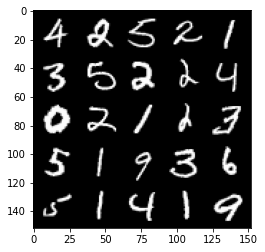

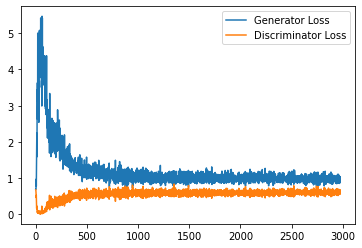

Step 60000: Generator loss: 0.9693431869745255, discriminator loss: 0.6119101172685624


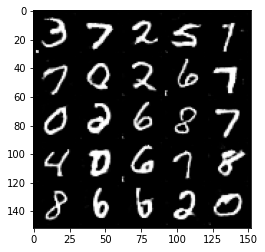

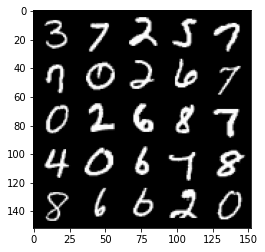

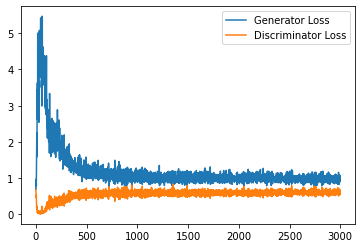

Step 60500: Generator loss: 0.978969576716423, discriminator loss: 0.6054382076859475


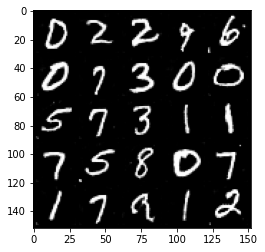

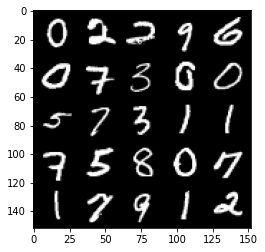

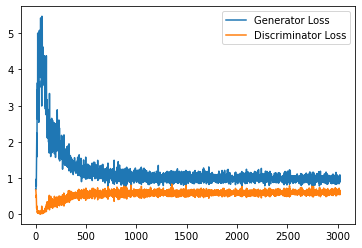

Step 61000: Generator loss: 0.9613803296089173, discriminator loss: 0.6121841279268265


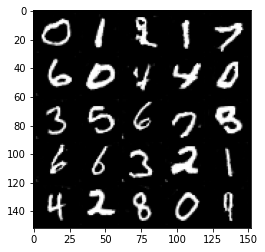

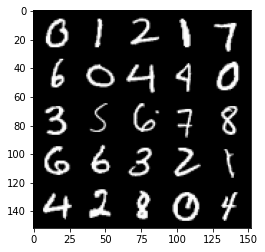

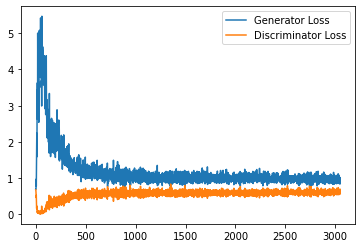

Step 61500: Generator loss: 0.9730749003887177, discriminator loss: 0.6083448356986045


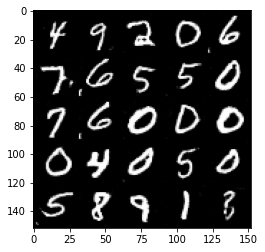

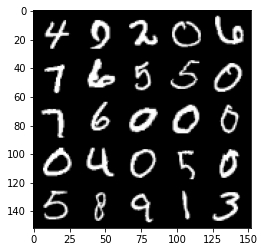

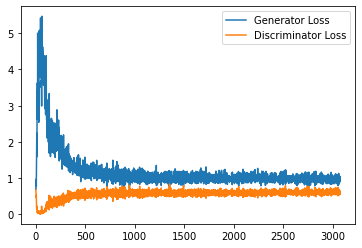

Step 62000: Generator loss: 0.9524709842205048, discriminator loss: 0.6104165177345275


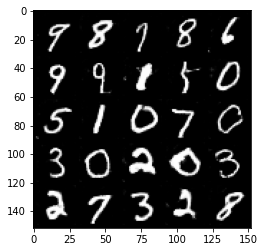

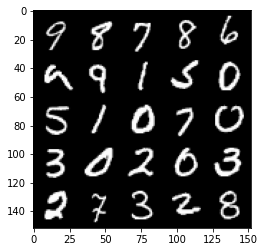

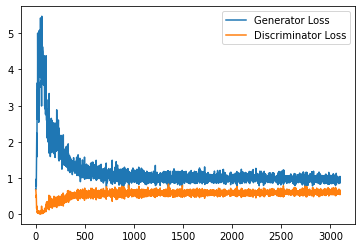

Step 62500: Generator loss: 0.9686793121099472, discriminator loss: 0.6066257417798042


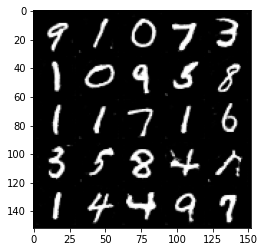

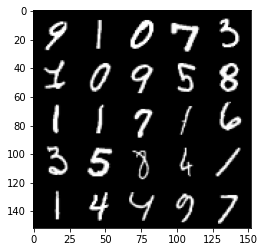

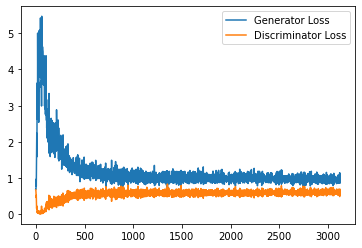

Step 63000: Generator loss: 0.9700181447267532, discriminator loss: 0.6127967700362206


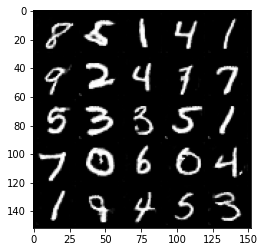

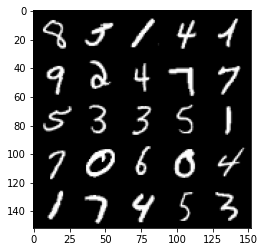

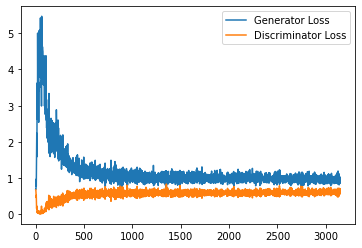

Step 63500: Generator loss: 0.9793952918052673, discriminator loss: 0.6069535372257233


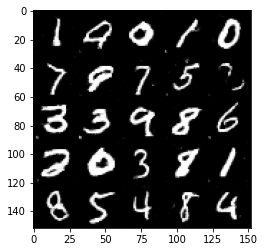

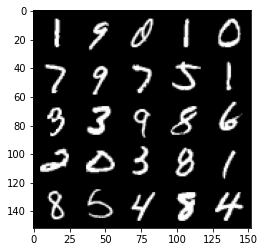

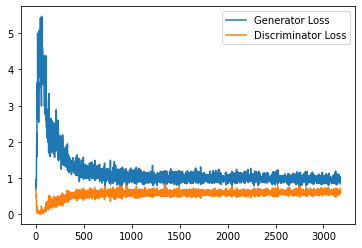

Step 64000: Generator loss: 0.9675342986583709, discriminator loss: 0.6131896187067032


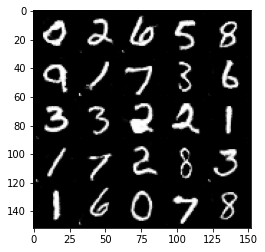

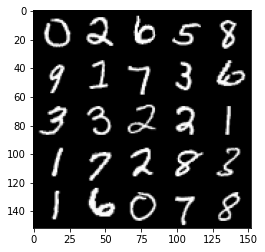

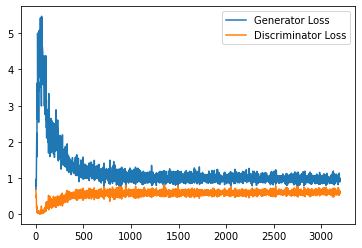

Step 64500: Generator loss: 0.9617716963291169, discriminator loss: 0.6137253571152687


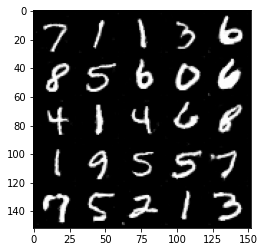

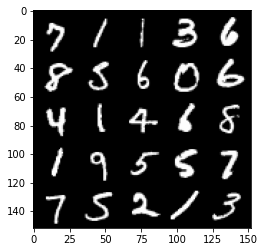

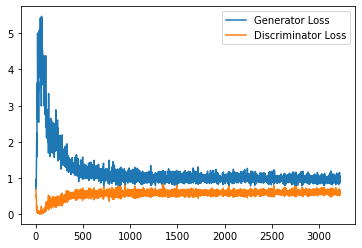

Step 65000: Generator loss: 0.9597371534109116, discriminator loss: 0.6056729339361191


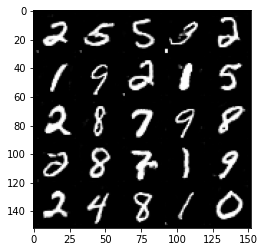

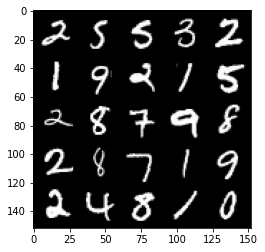

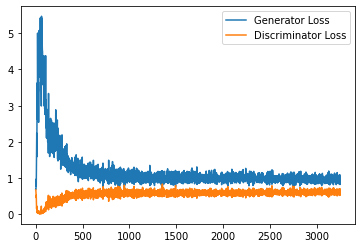

Step 65500: Generator loss: 0.977634014248848, discriminator loss: 0.6088016830086708


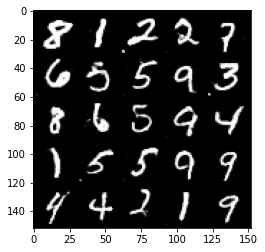

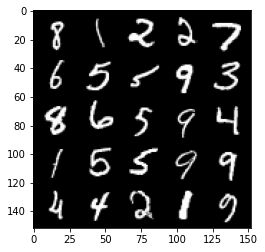

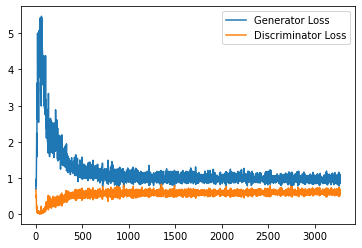

Step 66000: Generator loss: 0.956091943860054, discriminator loss: 0.6094635152816772


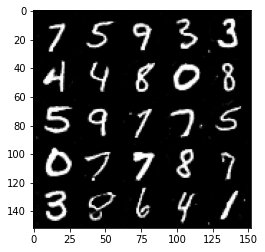

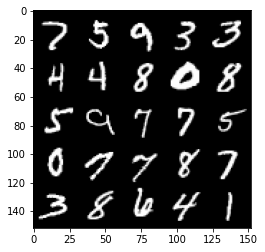

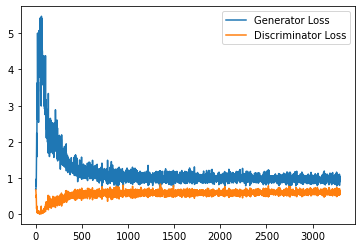

Step 66500: Generator loss: 0.9525590668916702, discriminator loss: 0.6125126482844353


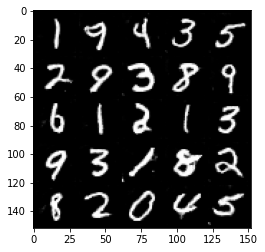

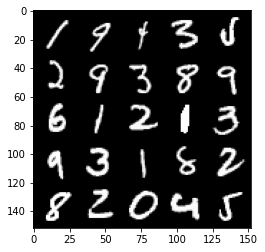

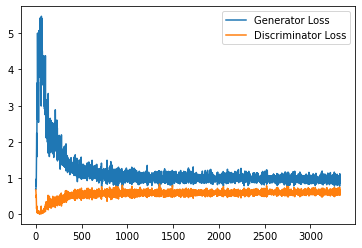

Step 67000: Generator loss: 0.982653550028801, discriminator loss: 0.6046024947166443


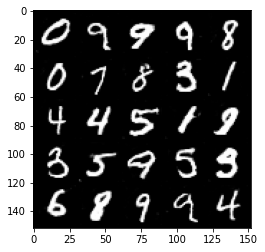

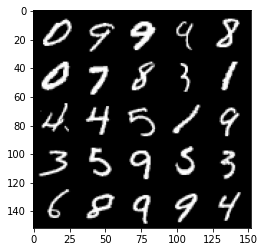

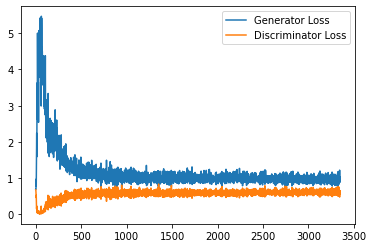

Step 67500: Generator loss: 0.9689454898834229, discriminator loss: 0.6158570508956909


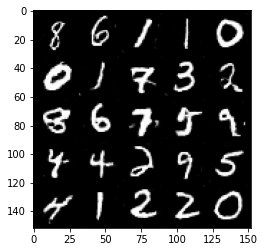

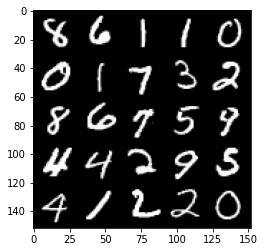

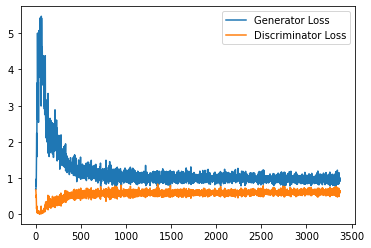

Step 68000: Generator loss: 0.9515449289083481, discriminator loss: 0.6104198428988457


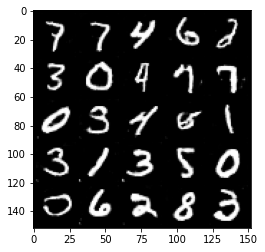

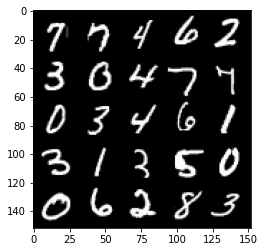

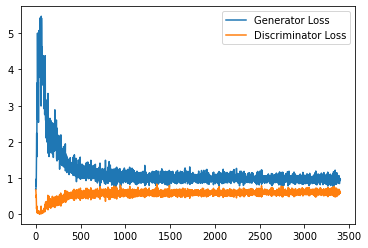

Step 68500: Generator loss: 0.9661412564516068, discriminator loss: 0.610734773337841


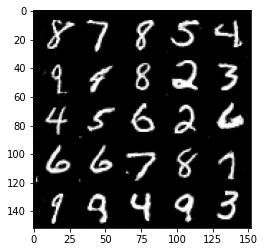

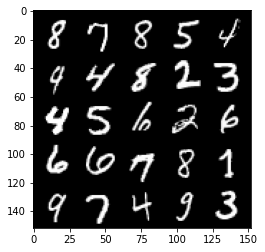

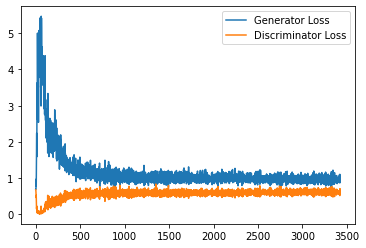

Step 69000: Generator loss: 0.9718854820728302, discriminator loss: 0.6119177187681198


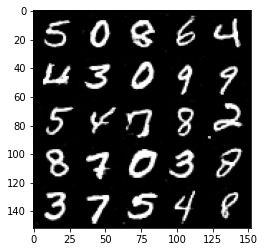

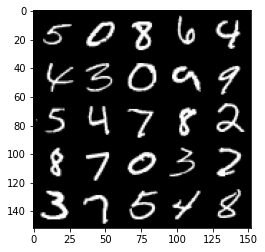

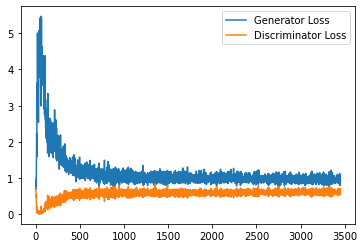

Step 69500: Generator loss: 0.9457402981519699, discriminator loss: 0.6210462260842323


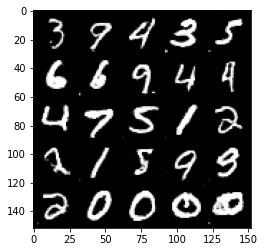

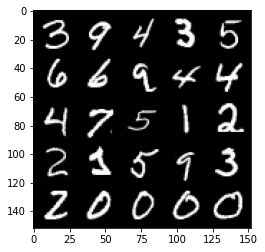

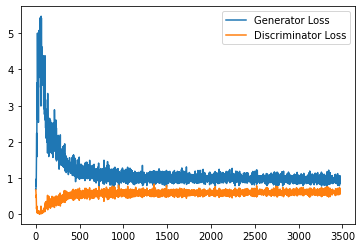

Step 70000: Generator loss: 0.9648590083122254, discriminator loss: 0.6148458843231202


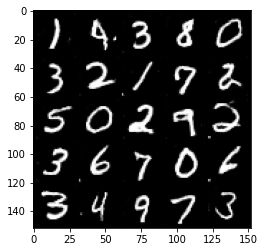

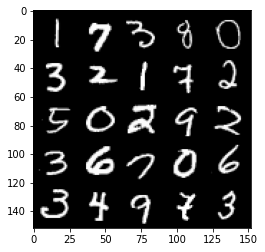

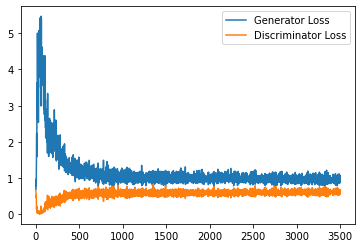

Step 70500: Generator loss: 0.9656059085130692, discriminator loss: 0.6120974727272988


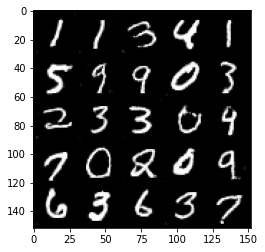

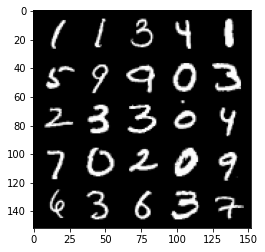

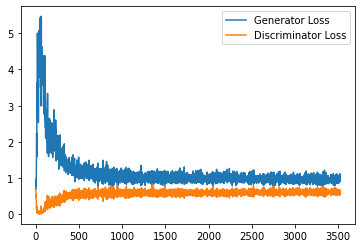

Step 71000: Generator loss: 0.9474322265386581, discriminator loss: 0.6205277750492096


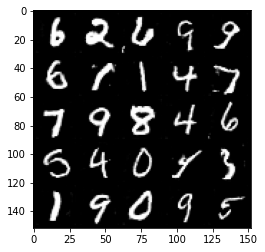

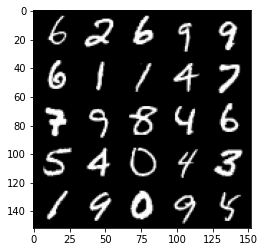

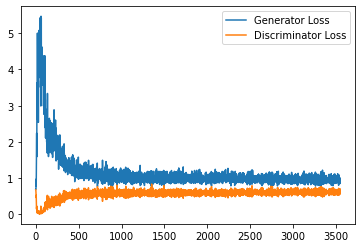

Step 71500: Generator loss: 0.9525684196949005, discriminator loss: 0.6144038020968438


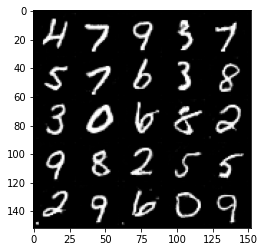

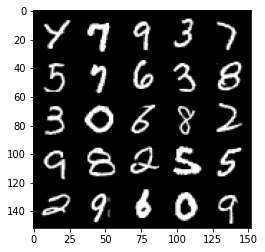

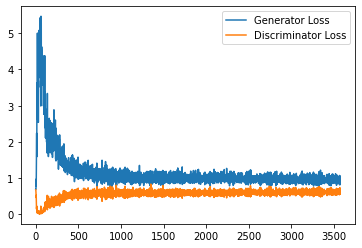

Step 72000: Generator loss: 0.9500769511461258, discriminator loss: 0.6170760043859482


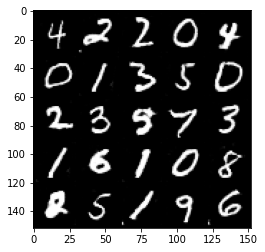

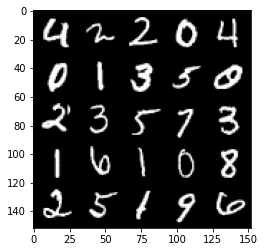

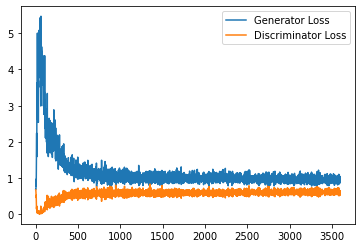

Step 72500: Generator loss: 0.9456543316841125, discriminator loss: 0.6217122171521187


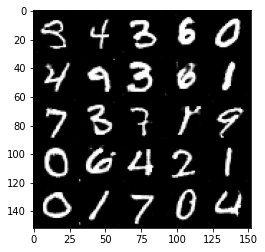

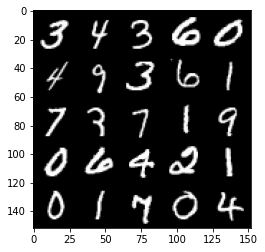

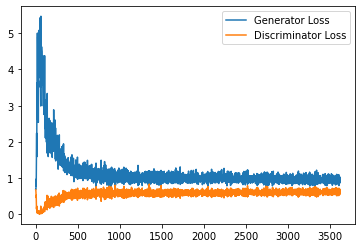

Step 73000: Generator loss: 0.938910921216011, discriminator loss: 0.6145551686286926


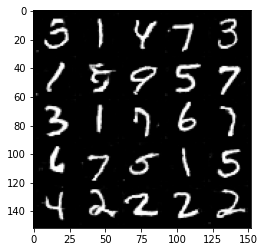

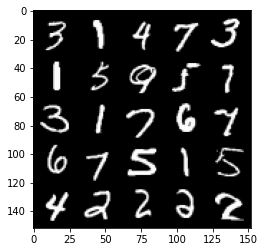

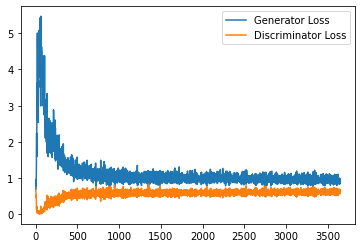

Step 73500: Generator loss: 0.9614451124668121, discriminator loss: 0.6142903574705124


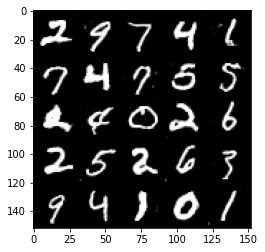

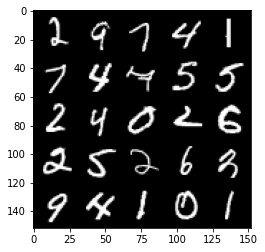

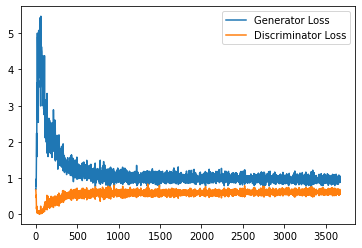

Step 74000: Generator loss: 0.9474458616971969, discriminator loss: 0.6177063781619072


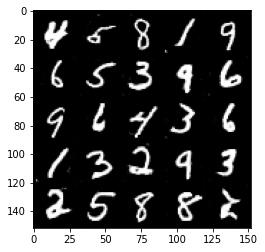

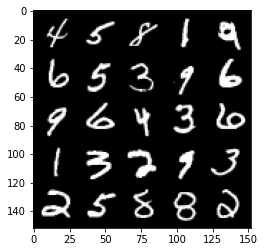

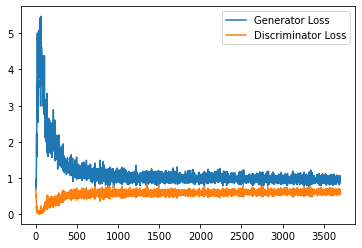

Step 74500: Generator loss: 0.9507470136880875, discriminator loss: 0.6163775669932365


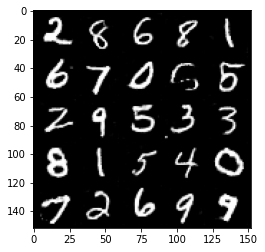

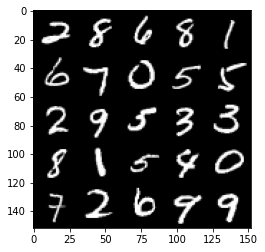

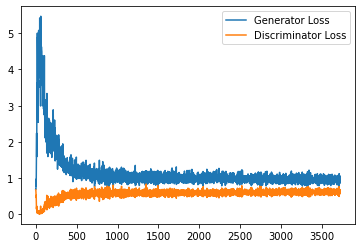

Step 75000: Generator loss: 0.9519889613389969, discriminator loss: 0.6192690933942795


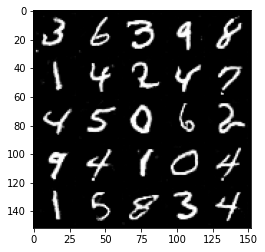

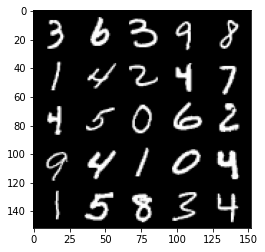

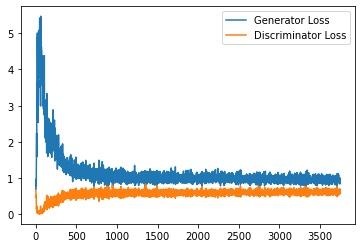

Step 75500: Generator loss: 0.9543124933242798, discriminator loss: 0.6193242727518081


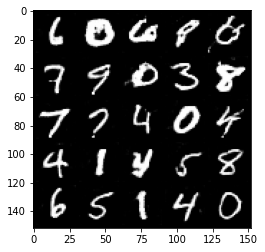

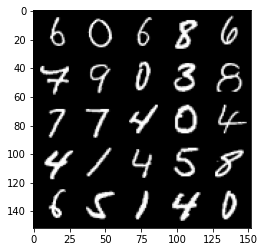

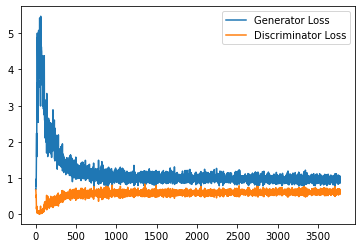

Step 76000: Generator loss: 0.943259270787239, discriminator loss: 0.6203212206363677


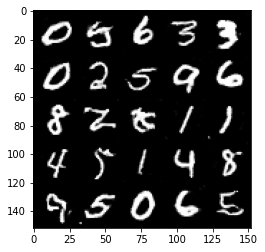

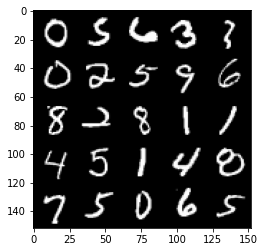

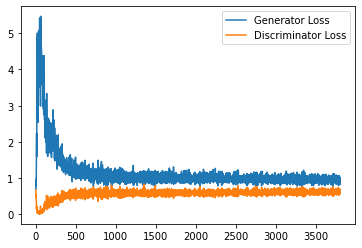

Step 76500: Generator loss: 0.9713011265993118, discriminator loss: 0.6137527561187744


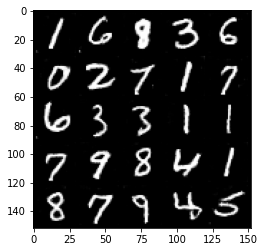

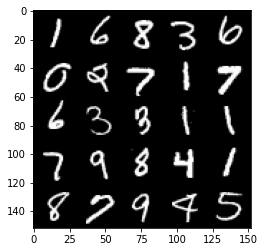

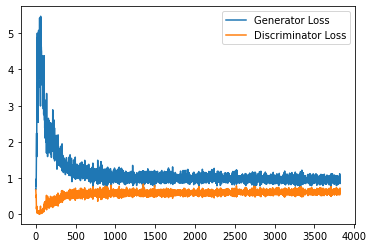

Step 77000: Generator loss: 0.9349069277048111, discriminator loss: 0.6248230636715889


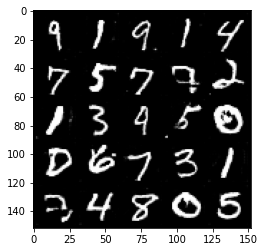

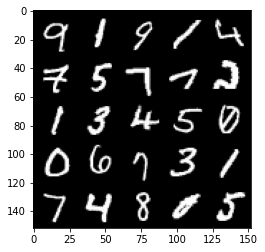

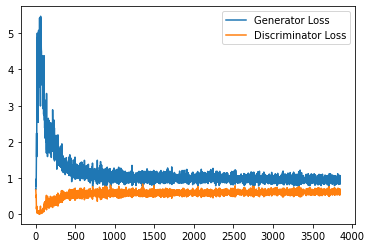

Step 77500: Generator loss: 0.9444263855218887, discriminator loss: 0.6209445029497147


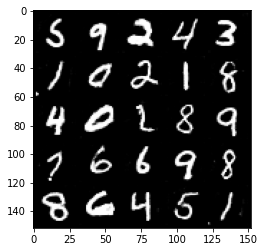

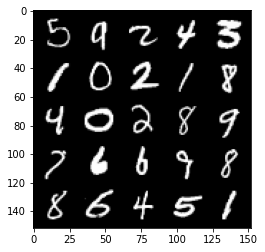

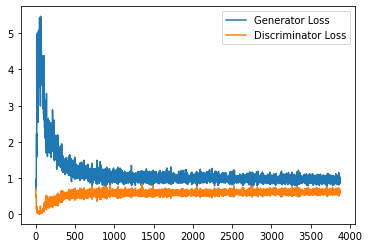

Step 78000: Generator loss: 0.9480962697267532, discriminator loss: 0.6163593446612358


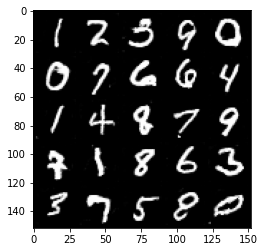

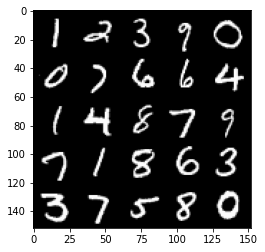

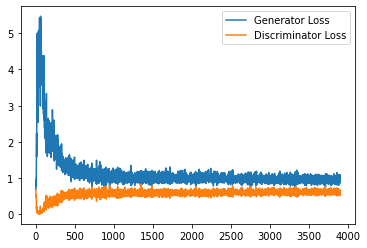

Step 78500: Generator loss: 0.9601888678073883, discriminator loss: 0.6149538368582725


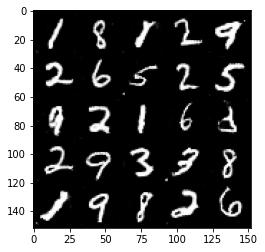

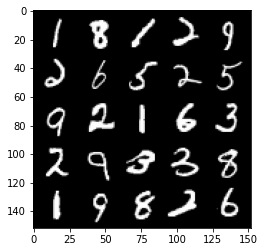

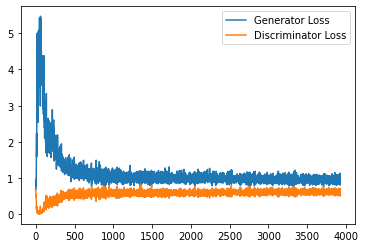

Step 79000: Generator loss: 0.9507011145353317, discriminator loss: 0.6166678371429444


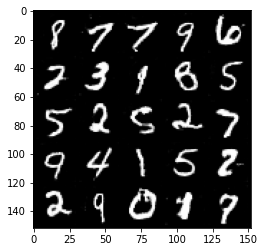

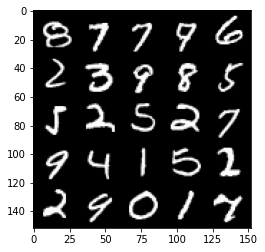

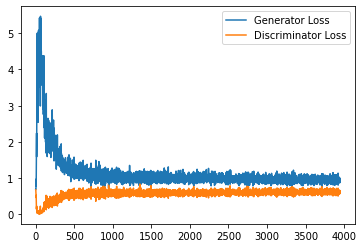

Step 79500: Generator loss: 0.942565835237503, discriminator loss: 0.617699352324009


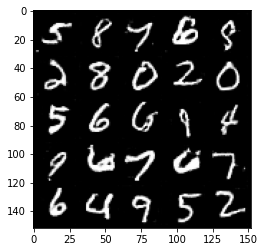

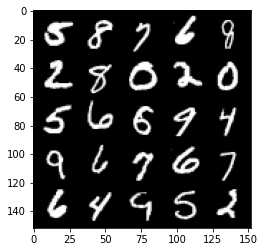

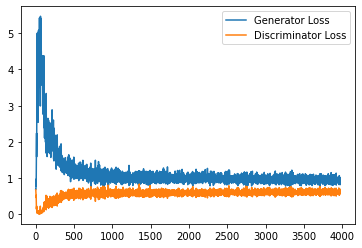

Step 80000: Generator loss: 0.9432110660076142, discriminator loss: 0.6208539562225341


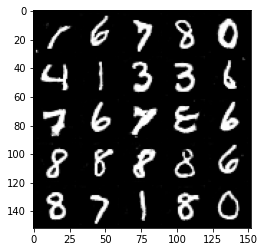

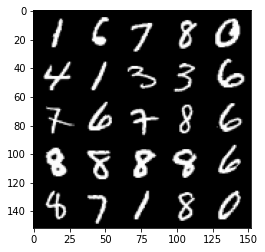

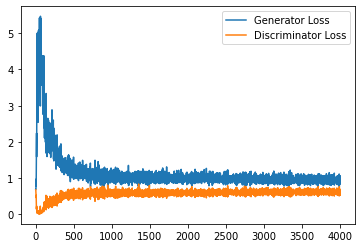

Step 80500: Generator loss: 0.9434561856985092, discriminator loss: 0.6199331285953522


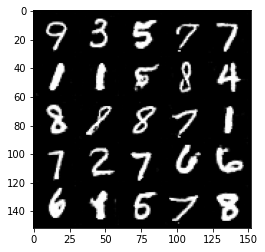

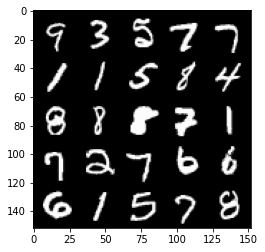

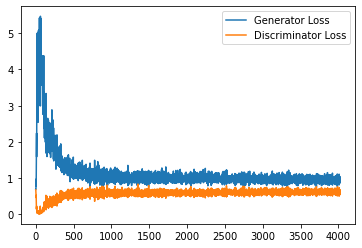

Step 81000: Generator loss: 0.9466984061002731, discriminator loss: 0.6181311773657798


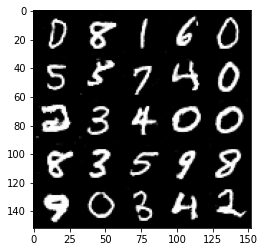

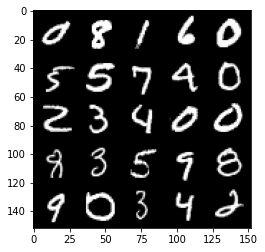

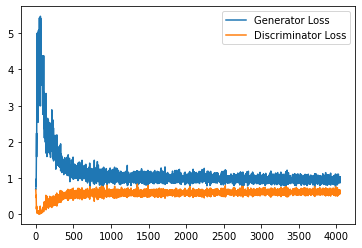

Step 81500: Generator loss: 0.9309672895669937, discriminator loss: 0.6228794394731522


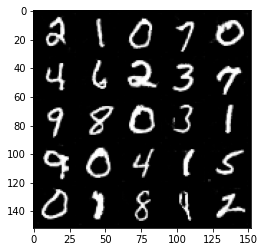

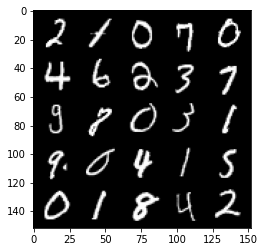

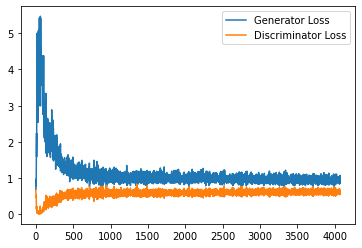

Step 82000: Generator loss: 0.948879687666893, discriminator loss: 0.620538073182106


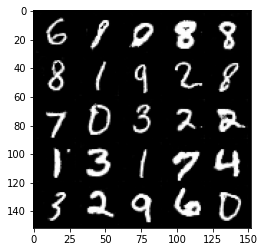

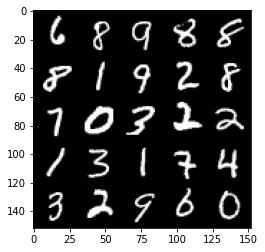

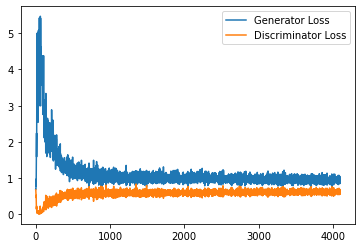

Step 82500: Generator loss: 0.9349417620897293, discriminator loss: 0.626466301381588


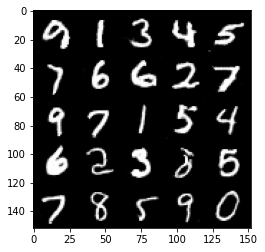

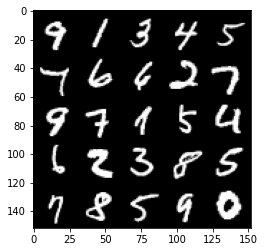

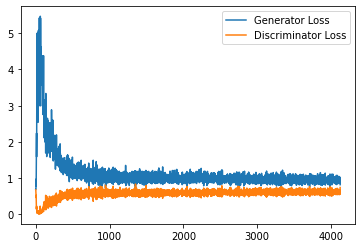

Step 83000: Generator loss: 0.9436247118711472, discriminator loss: 0.615610615670681


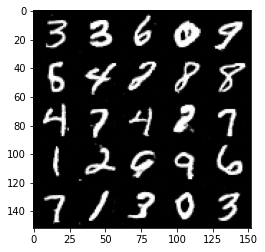

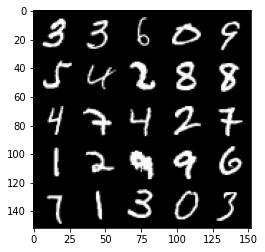

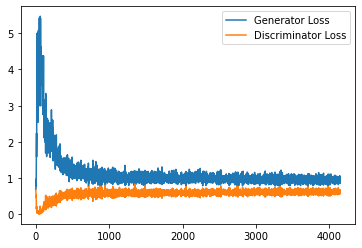

Step 83500: Generator loss: 0.9435713522434235, discriminator loss: 0.6237646893262864


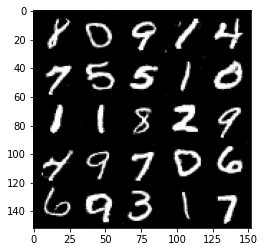

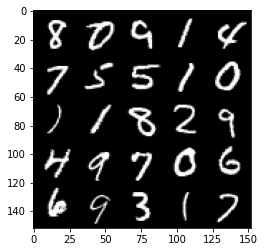

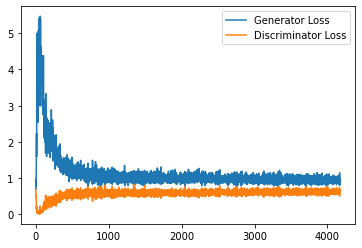

Step 84000: Generator loss: 0.9461004145145416, discriminator loss: 0.6152031763792037


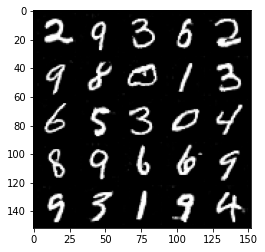

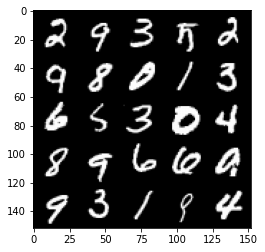

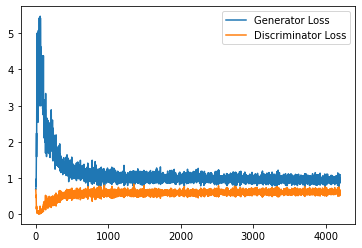

Step 84500: Generator loss: 0.9308501514196396, discriminator loss: 0.6191785215139389


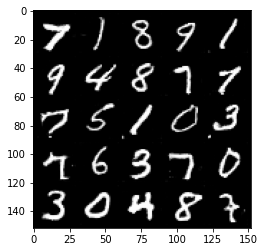

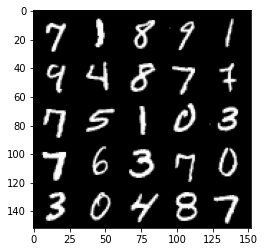

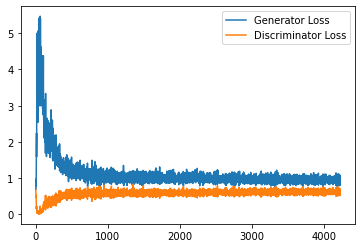

Step 85000: Generator loss: 0.9416613138914108, discriminator loss: 0.6188801152706146


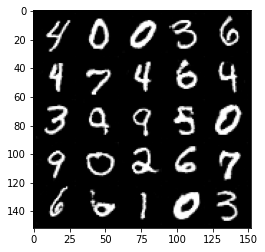

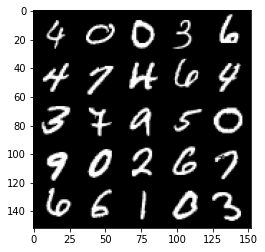

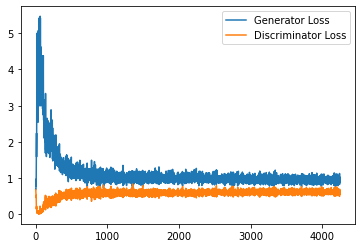

Step 85500: Generator loss: 0.9412214986085892, discriminator loss: 0.6292387754917145


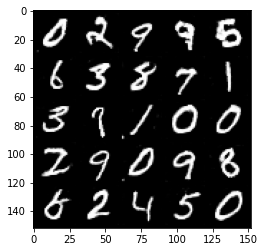

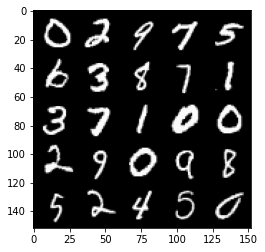

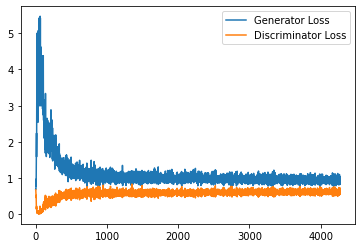

Step 86000: Generator loss: 0.9560924619436264, discriminator loss: 0.6190318674445152


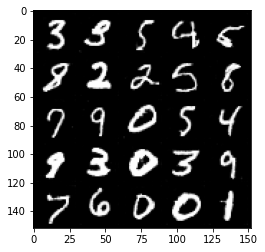

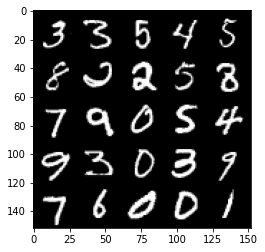

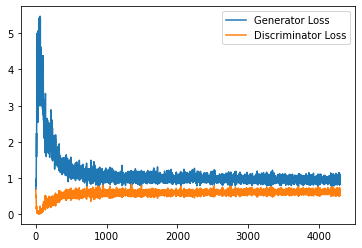

Step 86500: Generator loss: 0.9397546787261963, discriminator loss: 0.6167776370048523


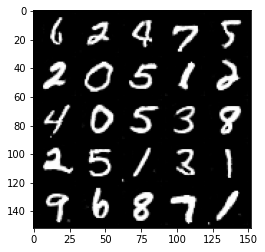

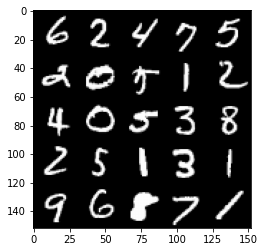

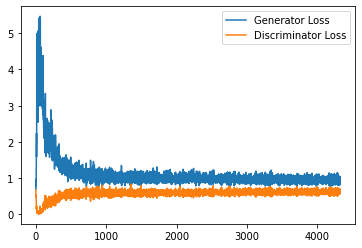

Step 87000: Generator loss: 0.9226168884038926, discriminator loss: 0.6268176113963128


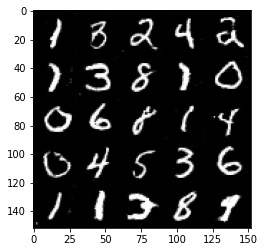

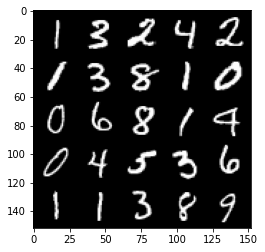

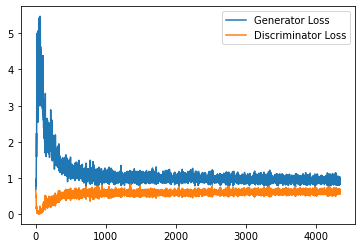

Step 87500: Generator loss: 0.9340735080242157, discriminator loss: 0.6152000796198845


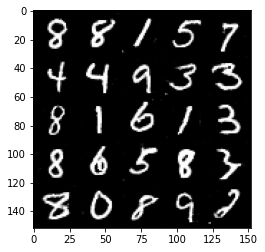

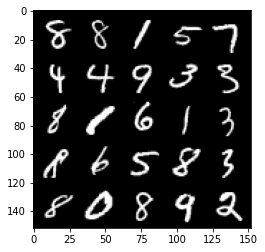

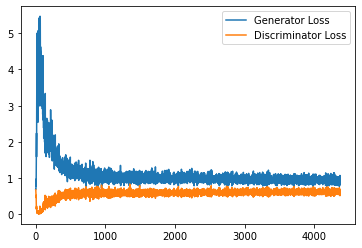

Step 88000: Generator loss: 0.9413141503334045, discriminator loss: 0.6178896813988686


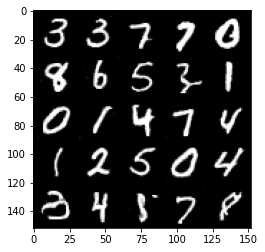

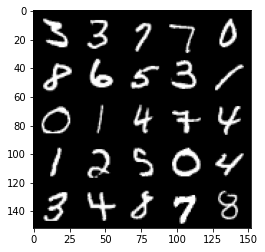

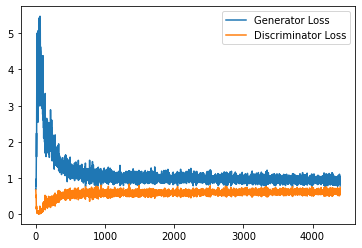

Step 88500: Generator loss: 0.9404247045516968, discriminator loss: 0.618794599890709


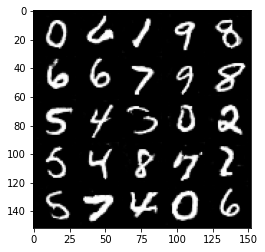

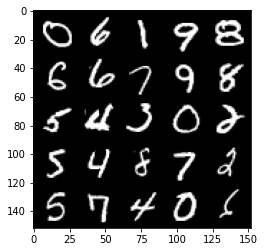

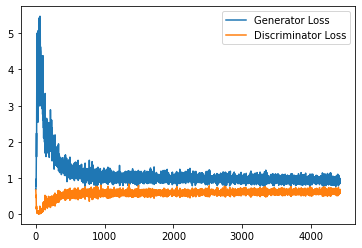

Step 89000: Generator loss: 0.9408090232610703, discriminator loss: 0.622048463344574


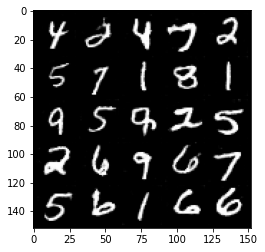

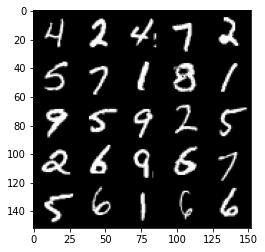

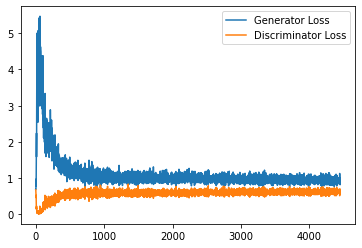

Step 89500: Generator loss: 0.9370065965652465, discriminator loss: 0.6182642479538918


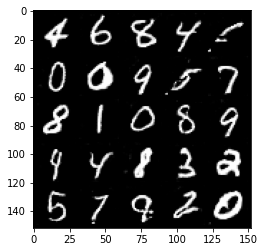

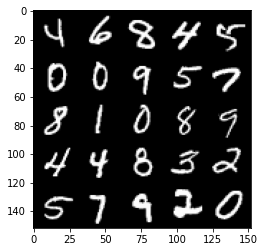

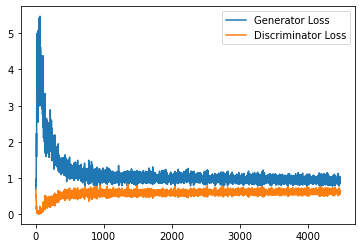

Step 90000: Generator loss: 0.9555319685935975, discriminator loss: 0.6150130490064621


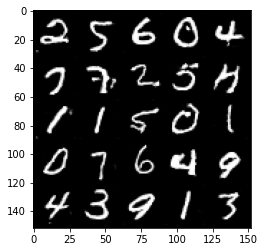

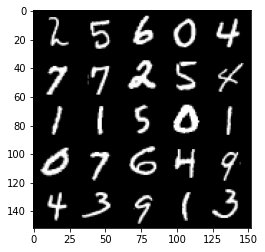

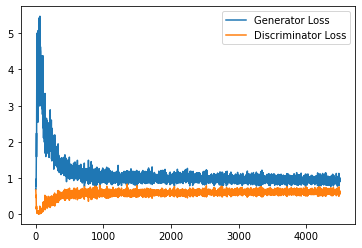

Step 90500: Generator loss: 0.941364242553711, discriminator loss: 0.6256850574016571


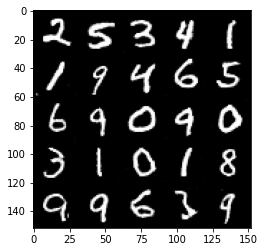

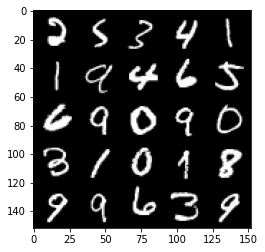

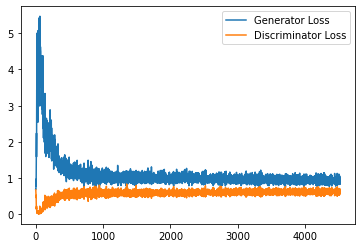

Step 91000: Generator loss: 0.9367412029504776, discriminator loss: 0.6211795167922973


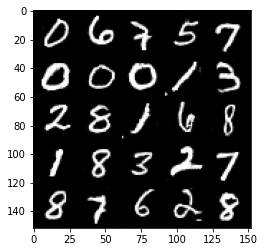

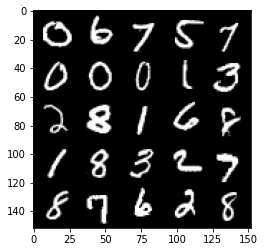

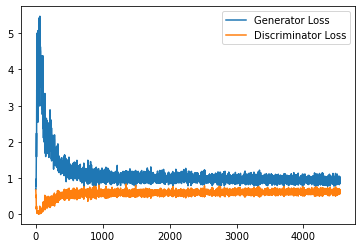

Step 91500: Generator loss: 0.9264504712820053, discriminator loss: 0.6251638291478157


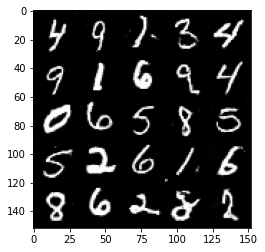

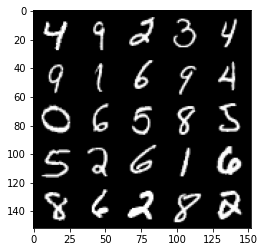

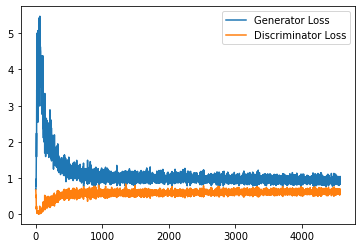

Step 92000: Generator loss: 0.9376683382987976, discriminator loss: 0.6195828195810318


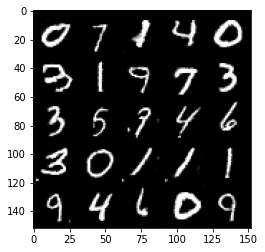

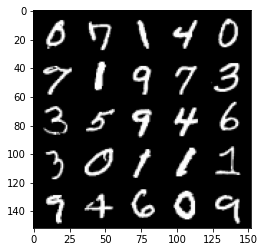

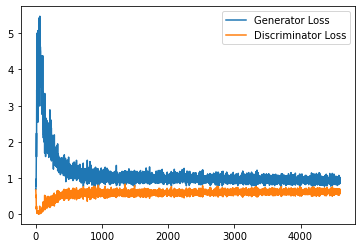

Step 92500: Generator loss: 0.9543626836538315, discriminator loss: 0.6242605823874473


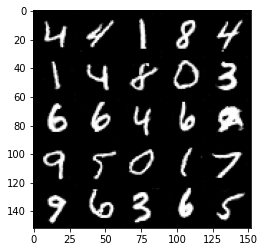

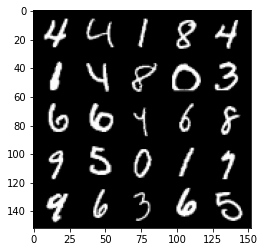

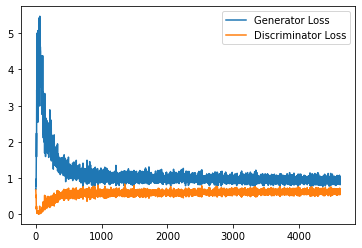

Step 93000: Generator loss: 0.9241297117471695, discriminator loss: 0.6227744041085244


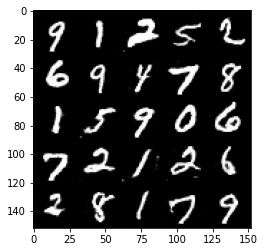

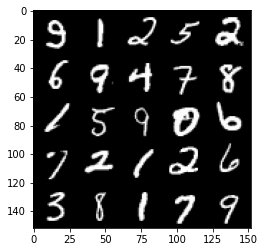

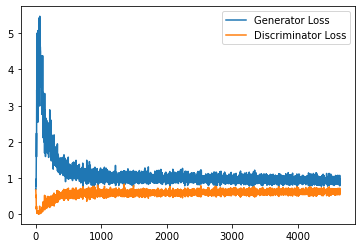

Step 93500: Generator loss: 0.9447949330806732, discriminator loss: 0.6209103233814239


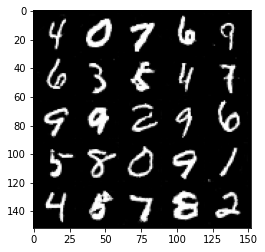

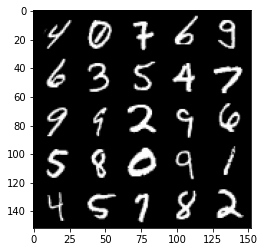

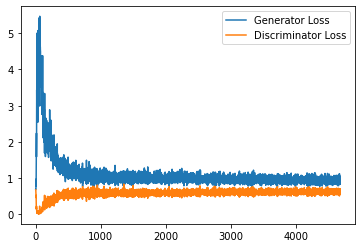

In [13]:
# UNQ_C4 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED CELL
cur_step = 0
generator_losses = []
discriminator_losses = []

#UNIT TEST NOTE: Initializations needed for grading
noise_and_labels = False
fake = False

fake_image_and_labels = False
real_image_and_labels = False
disc_fake_pred = False
disc_real_pred = False

for epoch in range(n_epochs):
    # Dataloader returns the batches and the labels
    for real, labels in tqdm(dataloader):
        cur_batch_size = len(real)
        # Flatten the batch of real images from the dataset
        real = real.to(device)

        one_hot_labels = get_one_hot_labels(labels.to(device), n_classes)
        image_one_hot_labels = one_hot_labels[:, :, None, None]
        image_one_hot_labels = image_one_hot_labels.repeat(1, 1, mnist_shape[1], mnist_shape[2])

        ### Update discriminator ###
        # Zero out the discriminator gradients
        disc_opt.zero_grad()
        # Get noise corresponding to the current batch_size 
        fake_noise = get_noise(cur_batch_size, z_dim, device=device)
        
        # Now you can get the images from the generator
        # Steps: 1) Combine the noise vectors and the one-hot labels for the generator
        #        2) Generate the conditioned fake images
       
        
        noise_and_labels = combine_vectors(fake_noise, one_hot_labels)
        fake = gen(noise_and_labels)
        
        
        # Make sure that enough images were generated
        assert len(fake) == len(real)
        # Check that correct tensors were combined
        assert tuple(noise_and_labels.shape) == (cur_batch_size, fake_noise.shape[1] + one_hot_labels.shape[1])
        # It comes from the correct generator
        assert tuple(fake.shape) == (len(real), 1, 28, 28)

        # Now you can get the predictions from the discriminator
        # Steps: 1) Create the input for the discriminator
        #           a) Combine the fake images with image_one_hot_labels, 
        #              remember to detach the generator (.detach()) so you do not backpropagate through it
        #           b) Combine the real images with image_one_hot_labels
        #        2) Get the discriminator's prediction on the fakes as disc_fake_pred
        #        3) Get the discriminator's prediction on the reals as disc_real_pred
        
        
        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        real_image_and_labels = combine_vectors(real, image_one_hot_labels)
        disc_fake_pred = disc(fake_image_and_labels.detach())
        disc_real_pred = disc(real_image_and_labels)
        
        
        # Make sure shapes are correct 
        assert tuple(fake_image_and_labels.shape) == (len(real), fake.detach().shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        assert tuple(real_image_and_labels.shape) == (len(real), real.shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        # Make sure that enough predictions were made
        assert len(disc_real_pred) == len(real)
        # Make sure that the inputs are different
        assert torch.any(fake_image_and_labels != real_image_and_labels)
        # Shapes must match
        assert tuple(fake_image_and_labels.shape) == tuple(real_image_and_labels.shape)
        assert tuple(disc_fake_pred.shape) == tuple(disc_real_pred.shape)
        
        
        disc_fake_loss = criterion(disc_fake_pred, torch.zeros_like(disc_fake_pred))
        disc_real_loss = criterion(disc_real_pred, torch.ones_like(disc_real_pred))
        disc_loss = (disc_fake_loss + disc_real_loss) / 2
        disc_loss.backward(retain_graph=True)
        disc_opt.step() 

        # Keep track of the average discriminator loss
        discriminator_losses += [disc_loss.item()]

        ### Update generator ###
        # Zero out the generator gradients
        gen_opt.zero_grad()

        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        # This will error if you didn't concatenate your labels to your image correctly
        disc_fake_pred = disc(fake_image_and_labels)
        gen_loss = criterion(disc_fake_pred, torch.ones_like(disc_fake_pred))
        gen_loss.backward()
        gen_opt.step()

        # Keep track of the generator losses
        generator_losses += [gen_loss.item()]
        #

        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            disc_mean = sum(discriminator_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, discriminator loss: {disc_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            x_axis = sorted([i * step_bins for i in range(len(generator_losses) // step_bins)] * step_bins)
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(discriminator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Discriminator Loss"
            )
            plt.legend()
            plt.show()
        elif cur_step == 0:
            print("Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!")
        cur_step += 1

## Exploration
You can do a bit of exploration now!

In [14]:
# Before you explore, you should put the generator
# in eval mode, both in general and so that batch norm
# doesn't cause you issues and is using its eval statistics
gen = gen.eval()

#### Changing the Class Vector
You can generate some numbers with your new model! You can add interpolation as well to make it more interesting.

So starting from a image, you will produce intermediate images that look more and more like the ending image until you get to the final image. Your're basically morphing one image into another. You can choose what these two images will be using your conditional GAN.

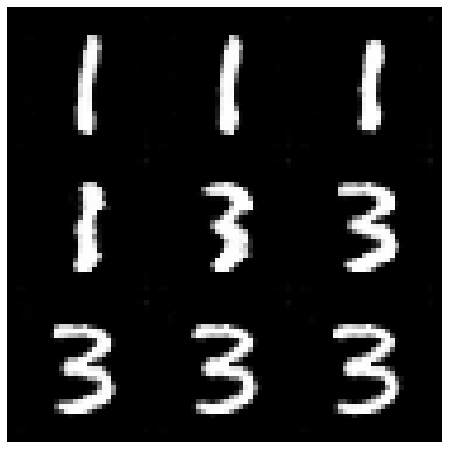

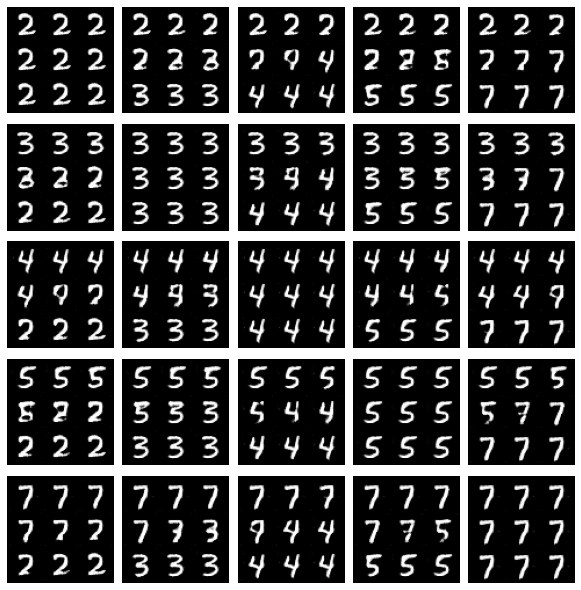

In [21]:
import math

### Change me! ###
n_interpolation = 9 # Choose the interpolation: how many intermediate images you want + 2 (for the start and end image)
interpolation_noise = get_noise(1, z_dim, device=device).repeat(n_interpolation, 1)

def interpolate_class(first_number, second_number):
    first_label = get_one_hot_labels(torch.Tensor([first_number]).long(), n_classes)
    second_label = get_one_hot_labels(torch.Tensor([second_number]).long(), n_classes)

    # Calculate the interpolation vector between the two labels
    percent_second_label = torch.linspace(0, 1, n_interpolation)[:, None]
    interpolation_labels = first_label * (1 - percent_second_label) + second_label * percent_second_label

    # Combine the noise and the labels
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_labels.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

### Change me! ###
start_plot_number = 1 # Choose the start digit
### Change me! ###
end_plot_number = 3 # Choose the end digit

plt.figure(figsize=(8, 8))
interpolate_class(start_plot_number, end_plot_number)
_ = plt.axis('off')

### Uncomment the following lines of code if you would like to visualize a set of pairwise class 
### interpolations for a collection of different numbers, all in a single grid of interpolations.
### You'll also see another visualization like this in the next code block!
plot_numbers = [2, 3, 4, 5, 7]
n_numbers = len(plot_numbers)
plt.figure(figsize=(8, 8))
for i, first_plot_number in enumerate(plot_numbers):
    for j, second_plot_number in enumerate(plot_numbers):
        plt.subplot(n_numbers, n_numbers, i * n_numbers + j + 1)
        interpolate_class(first_plot_number, second_plot_number)
        plt.axis('off')
plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
plt.show()
plt.close()

#### Changing the Noise Vector
Now, what happens if you hold the class constant, but instead you change the noise vector? You can also interpolate the noise vector and generate an image at each step.

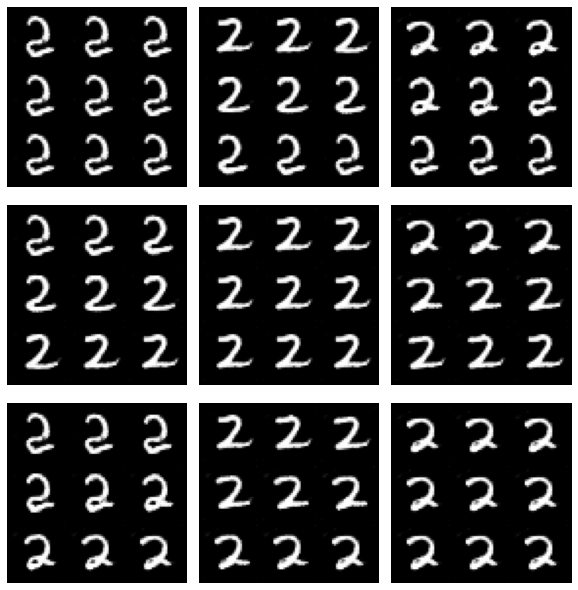

In [29]:
n_interpolation = 9 # How many intermediate images you want + 2 (for the start and end image)

# This time you're interpolating between the noise instead of the labels
interpolation_label = get_one_hot_labels(torch.Tensor([2]).long(), n_classes).repeat(n_interpolation, 1).float()

def interpolate_noise(first_noise, second_noise):
    # This time you're interpolating between the noise instead of the labels
    percent_first_noise = torch.linspace(0, 1, n_interpolation)[:, None].to(device)
    interpolation_noise = first_noise * percent_first_noise + second_noise * (1 - percent_first_noise)

    # Combine the noise and the labels again
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_label.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

# Generate noise vectors to interpolate between
### Change me! ###
n_noise = 3 # Choose the number of noise examples in the grid
plot_noises = [get_noise(1, z_dim, device=device) for i in range(n_noise)]
plt.figure(figsize=(8, 8))
for i, first_plot_noise in enumerate(plot_noises):
    for j, second_plot_noise in enumerate(plot_noises):
        plt.subplot(n_noise, n_noise, i * n_noise + j + 1)
        interpolate_noise(first_plot_noise, second_plot_noise)
        plt.axis('off')
plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
plt.show()
plt.close()